In [369]:
import pandas as pd
owid = pd.read_csv('./covid-19-data-master/public/data/owid-covid-data.csv')
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os

import seaborn as sns
from datetime import datetime
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns; sns.set(style='white')
#%config InlineBackend.figure_format = 'retina'
from mpl_toolkits.mplot3d import Axes3D
import scipy as sp

from scipy.cluster import hierarchy
from scipy.spatial.distance import pdist
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

from sklearn import ensemble, decomposition
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.model_selection import train_test_split 
from sklearn.pipeline import Pipeline
import plotly.graph_objs as go
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeClassifier #Decision Tree
from fbprophet import Prophet
from fbprophet.plot import plot_plotly, add_changepoints_to_plot


In [ ]:
def build_model(model_name):
    if model_name == 'linear':
        model = Pipeline([('poly', PolynomialFeatures(degree=2)),
                     ('linear', LinearRegression(fit_intercept=False))])
    elif model_name == 'xgboost':
        model =  xgb.XGBRegressor(n_estimators=20000,max_depth=5,reg_lambda=0.9, random_state=42)
        model.fit(X_train, y_train, early_stopping_rounds=300, eval_set=[(X_test, y_test)], verbose=False)
    elif model_name == 'linearregression':
        model = linear_model.LinearRegression()
    elif model_name == 'randomforest':
        model = RandomForestRegressor()
        model1 = RandomForestRegressor(n_jobs=-1,n_estimators = 100)
        model = Pipeline([('scaler2' , StandardScaler()),
                                ('RandomForestRegressor: ', model1)])
    elif model_name == 'decisiontree':
        model = DecisionTreeClassifier()
    return model

# from xgboost import plot_importance

# _, ax = plt.subplots(figsize=(7, 7))
# plot_importance(my_model, ax=ax)
# plt.show()
# def model2():

In [311]:
owid.isnull().sum()

iso_code                                     0
continent                                 4606
location                                     0
date                                         0
total_cases                               3418
new_cases                                 3421
new_cases_smoothed                        4431
total_deaths                             13501
new_deaths                               13345
new_deaths_smoothed                       4431
total_cases_per_million                   3922
new_cases_per_million                     3925
new_cases_smoothed_per_million            4930
total_deaths_per_million                 13992
new_deaths_per_million                   13836
new_deaths_smoothed_per_million           4930
reproduction_rate                        19105
icu_patients                             88071
icu_patients_per_million                 88071
hosp_patients                            85662
hosp_patients_per_million                85662
weekly_icu_ad

In [517]:
owid.dtypes

iso_code                                         object
continent                                        object
location                                         object
date                                     datetime64[ns]
total_cases                                     float64
new_cases                                       float64
new_cases_smoothed                              float64
total_deaths                                    float64
new_deaths                                      float64
new_deaths_smoothed                             float64
total_cases_per_million                         float64
new_cases_per_million                           float64
new_cases_smoothed_per_million                  float64
total_deaths_per_million                        float64
new_deaths_per_million                          float64
new_deaths_smoothed_per_million                 float64
reproduction_rate                               float64
icu_patients                                    

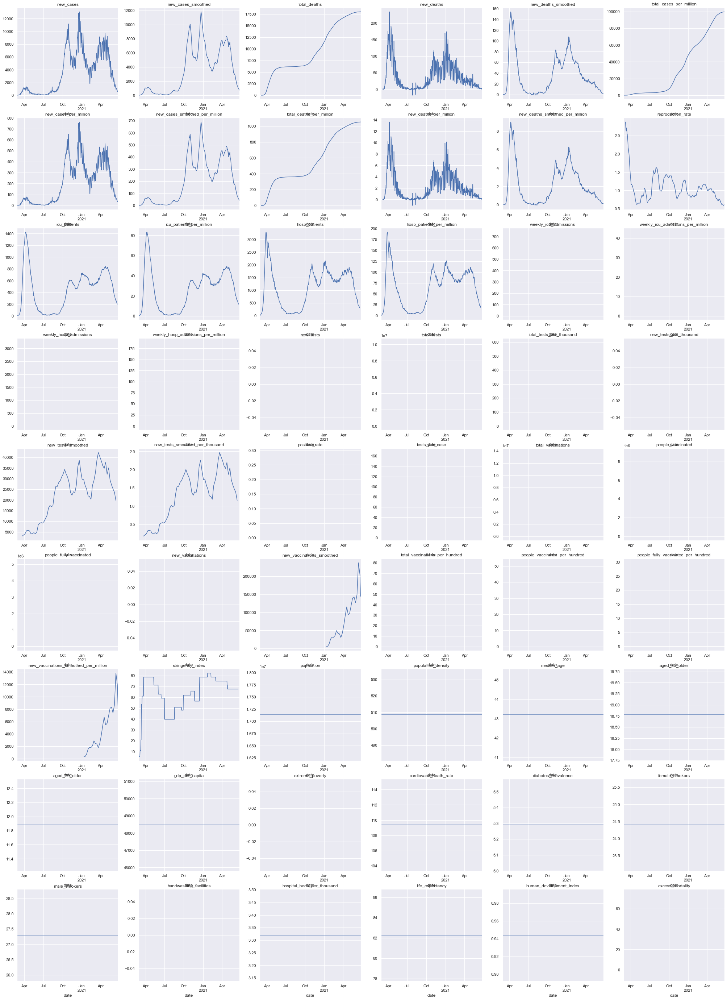

In [547]:
sns.set(style='darkgrid')
data = owid[owid['iso_code']=='NLD'].drop(['continent','location','tests_units'],axis=True)
data.index=data.date
# print(data.columns)
plt.figure(figsize= (35,55))
for i,col in enumerate(data.columns[3:]):
    plt.subplot(10,6,i+1)
    data[col].plot()
    plt.title(col)


In [ ]:
constan = ['population','population_density','median_age','aged_65_older','aged_70_older','gdp_per_capita',
           'cardiovasc_death_rate','female_smokers','male_smokers','hospital_beds_per_thousand','life_expectancy','human_development_index']

In [534]:
oxcgrt.dtypes

CountryName                               object
CountryCode                               object
RegionName                                object
RegionCode                                object
Jurisdiction                              object
Date                                       int64
C1_School closing                        float64
C1_Flag                                  float64
C2_Workplace closing                     float64
C2_Flag                                  float64
C3_Cancel public events                  float64
C3_Flag                                  float64
C4_Restrictions on gatherings            float64
C4_Flag                                  float64
C5_Close public transport                float64
C5_Flag                                  float64
C6_Stay at home requirements             float64
C6_Flag                                  float64
C7_Restrictions on internal movement     float64
C7_Flag                                  float64
C8_International tra

/Users/mac/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning:

Columns (2,3) have mixed types.Specify dtype option on import or set low_memory=False.



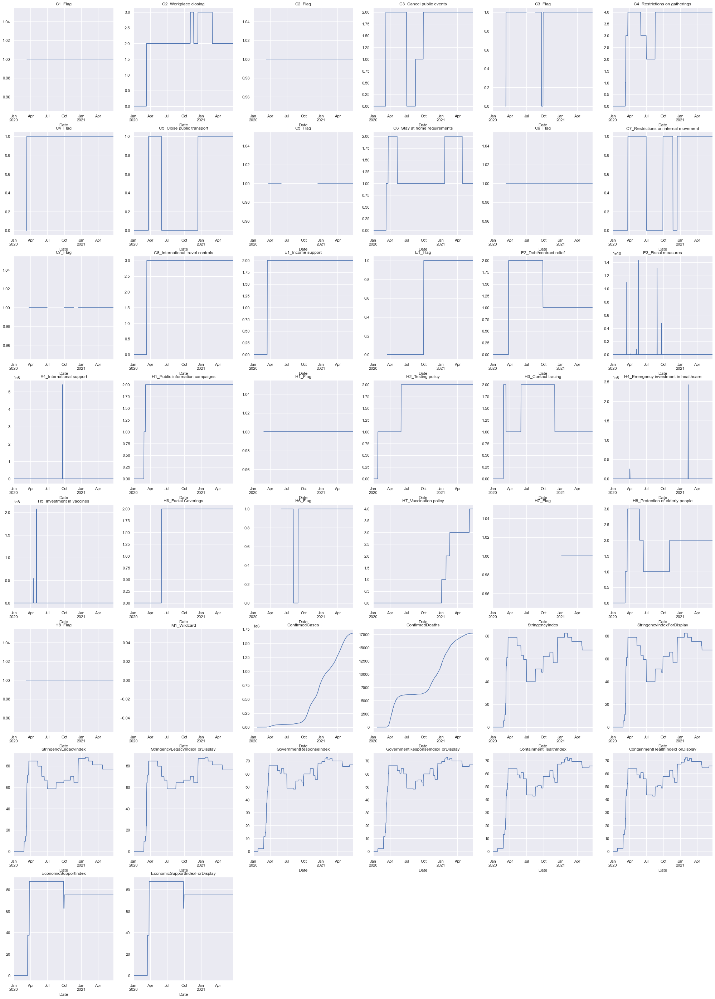

In [546]:
oxcgrt = pd.read_csv('./covid-policy-tracker-master/data/OxCGRT_latest.csv')
# sns.set(style='darkgrid')
data = oxcgrt[oxcgrt['CountryCode']=='NLD'].drop(['Jurisdiction','RegionCode','RegionName','CountryName'],axis=True)
data = data.sort_values('Date', ascending=True)
data['Date'] = pd.to_datetime(data['Date'], format = '%Y%m%d')
data.index=data.Date
# print(data.columns)
plt.figure(figsize= (35,50))
for i,col in enumerate(data.columns[3:]):
    plt.subplot(8,6,i+1)
    data[col].plot()
    plt.title(col)

In [604]:
europe_country_list = ['AUT','BEL','BGR','HRV','CYP','CZE','DNK','EST','FIN','FRA','DEU','GRC','HUN','IRL','ITA','LVA','LTU','LUX','MLT','NLD','POL','PRT','ROU','SVK','SVN','ESP','SWE','GBR']
europe_country_list = ['AUT','BEL','BGR','HRV','CZE','DNK','EST','FRA','DEU','GRC','HUN','IRL','ITA','LVA','LTU','LUX','NLD','POL','PRT','ROU','SVK','SVN','ESP','SWE','GBR']
world_cols = ['OWID_AFR','OWID_ASI','OWID_EUR','OWID_EUN','OWID_INT',
              'OWID_KOS','OWID_NAM','OWID_CYN','OWID_OCE','OWID_SAM','OWID_WRL']
country_list = ['NLD','IND','USA','BRA','NER']
country_list = ['NLD','IND','USA','BRA']
add_list = ['BES','CUW','SXM','SSD']
# country_list = europe_country_list
target_date = '2021-03-01'
target_date2 = '2021-05-01'

owid['date'] = pd.to_datetime(owid['date'], format = '%Y-%m-%d')



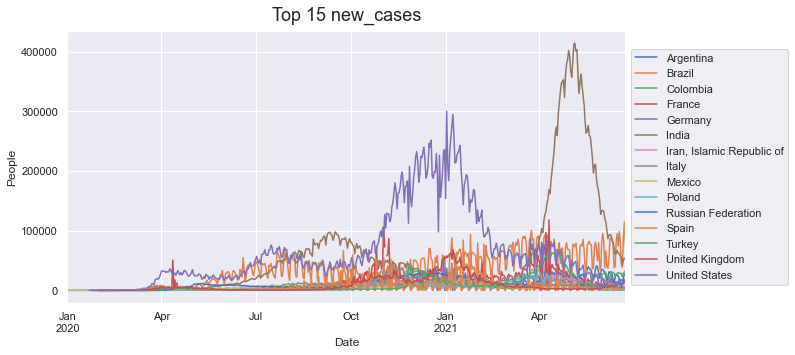

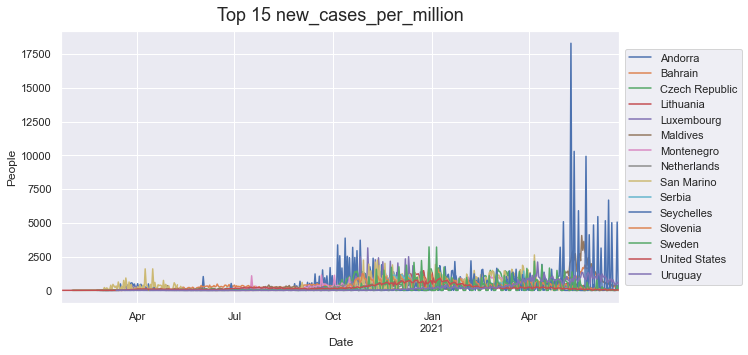

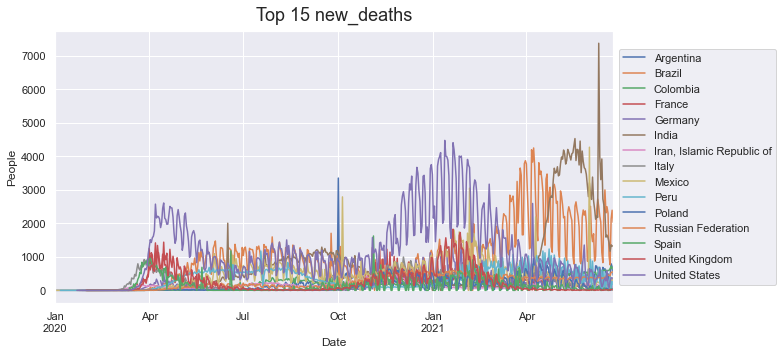

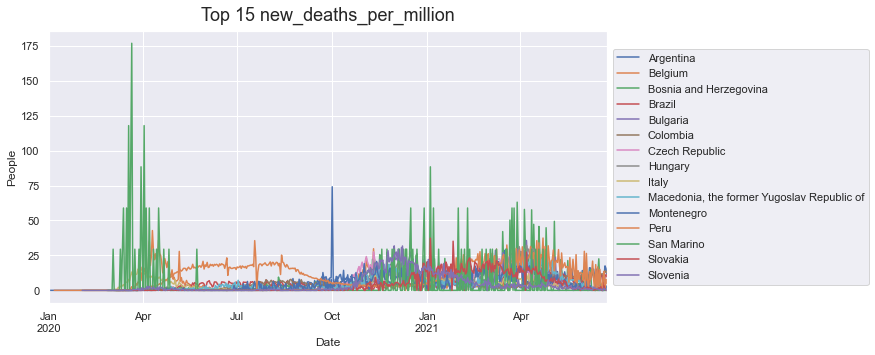

In [605]:
getTopList = 15
owid3=owid[~owid.iso_code.isin(world_cols)]
owid3= owid3[~owid3.iso_code.isin(add_list)]
owid3['iso_code'] = owid3['iso_code'].apply(convert_to_name)
def plot_top15(col_name):
    grouped_multiple = owid3.groupby(['iso_code'], as_index=False)[col_name].sum()
    countryTop = grouped_multiple.nlargest(getTopList, col_name)['iso_code']
    newList = owid3[owid3['iso_code'].isin(countryTop.values)]
    line = newList.groupby(['date', 'iso_code'], as_index=False)[col_name].sum()
    line = line[line[col_name] >= 0]

    line.pivot(index="date", columns="iso_code", values=col_name).plot(figsize=(10,5))
    plt.grid(zorder=0)
    plt.title('Top ' + str(getTopList) + ' ' +col_name, fontsize=18, pad=10)
    plt.ylabel('People')
    plt.xlabel('Date')
    plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
    plt.show()
    
plot_top15("new_cases")
plot_top15("new_cases_per_million")
plot_top15("new_deaths")
plot_top15("new_deaths_per_million")


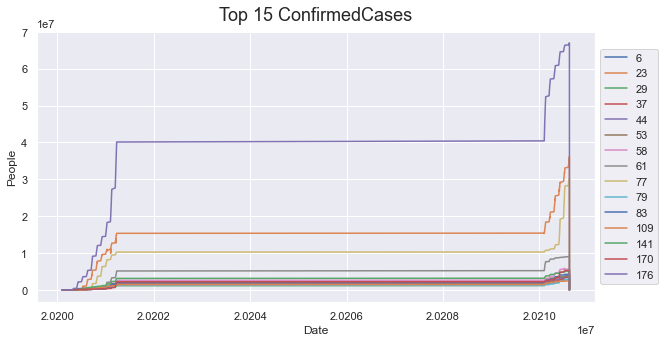

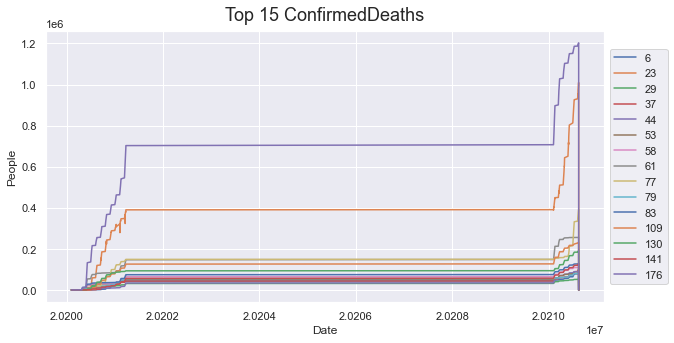

In [589]:
getTopList = 15
def plot_topox15(col_name):
    grouped_multiple = oxcgrt.groupby(['CountryCode'], as_index=False)[col_name].sum()
    countryTop = grouped_multiple.nlargest(getTopList, col_name)['CountryCode']
    newList = oxcgrt[oxcgrt['CountryCode'].isin(countryTop.values)]
    line = newList.groupby(['Date', 'CountryCode'], as_index=False)[col_name].sum()
    line = line[line[col_name] >= 0]

    line.pivot(index="Date", columns="CountryCode", values=col_name).plot(figsize=(10,5))
    plt.grid(zorder=0)
    plt.title('Top ' + str(getTopList) + ' ' +col_name, fontsize=18, pad=10)
    plt.ylabel('People')
    plt.xlabel('Date')
    plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
    plt.show()
    
plot_topox15("ConfirmedCases")
plot_topox15("ConfirmedDeaths")


In [596]:
convert23 = {
'AF':'AFG',
'AX':'ALA',
'AL':'ALB',
'DZ':'DZA',
'AS':'ASM',
'AD':'AND',
'AO':'AGO',
'AI':'AIA',
'AQ':'ATA',
'AG':'ATG',
'AR':'ARG',
'AM':'ARM',
'AW':'ABW',
'AU':'AUS',
'AT':'AUT',
'AZ':'AZE',
'BS':'BHS',
'BH':'BHR',
'BD':'BGD',
'BB':'BRB',
'BY':'BLR',
'BE':'BEL',
'BZ':'BLZ',
'BJ':'BEN',
'BM':'BMU',
'BT':'BTN',
'BO':'BOL',
'BA':'BIH',
'BW':'BWA',
'BV':'BVT',
'BR':'BRA',
'IO':'IOT',
'BN':'BRN',
'BG':'BGR',
'BF':'BFA',
'BI':'BDI',
'KH':'KHM',
'CM':'CMR',
'CA':'CAN',
'CV':'CPV',
'KY':'CYM',
'CF':'CAF',
'TD':'TCD',
'CL':'CHL',
'CN':'CHN',
'CX':'CXR',
'CC':'CCK',
'CO':'COL',
'KM':'COM',
'CG':'COG',
'CD':'COD',
'CK':'COK',
'CR':'CRI',
'CI':'CIV',
'HR':'HRV',
'CU':'CUB',
'CY':'CYP',
'CZ':'CZE',
'DK':'DNK',
'DJ':'DJI',
'DM':'DMA',
'DO':'DOM',
'EC':'ECU',
'EG':'EGY',
'SV':'SLV',
'GQ':'GNQ',
'ER':'ERI',
'EE':'EST',
'ET':'ETH',
'FK':'FLK',
'FO':'FRO',
'FJ':'FJI',
'FI':'FIN',
'FR':'FRA',
'GF':'GUF',
'PF':'PYF',
'TF':'ATF',
'GA':'GAB',
'GM':'GMB',
'GE':'GEO',
'DE':'DEU',
'GH':'GHA',
'GI':'GIB',
'GR':'GRC',
'GL':'GRL',
'GD':'GRD',
'GP':'GLP',
'GU':'GUM',
'GT':'GTM',
'GG':'GGY',
'GN':'GIN',
'GW':'GNB',
'GY':'GUY',
'HT':'HTI',
'HM':'HMD',
'VA':'VAT',
'HN':'HND',
'HK':'HKG',
'HU':'HUN',
'IS':'ISL',
'IN':'IND',
'ID':'IDN',
'IR':'IRN',
'IQ':'IRQ',
'IE':'IRL',
'IM':'IMN',
'IL':'ISR',
'IT':'ITA',
'JM':'JAM',
'JP':'JPN',
'JE':'JEY',
'JO':'JOR',
'KZ':'KAZ',
'KE':'KEN',
'KI':'KIR',
'KP':'PRK',
'KR':'KOR',
'KW':'KWT',
'KG':'KGZ',
'LA':'LAO',
'LV':'LVA',
'LB':'LBN',
'LS':'LSO',
'LR':'LBR',
'LY':'LBY',
'LI':'LIE',
'LT':'LTU',
'LU':'LUX',
'MO':'MAC',
'MK':'MKD',
'MG':'MDG',
'MW':'MWI',
'MY':'MYS',
'MV':'MDV',
'ML':'MLI',
'MT':'MLT',
'MH':'MHL',
'MQ':'MTQ',
'MR':'MRT',
'MU':'MUS',
'YT':'MYT',
'MX':'MEX',
'FM':'FSM',
'MD':'MDA',
'MC':'MCO',
'MN':'MNG',
'ME':'MNE',
'MS':'MSR',
'MA':'MAR',
'MZ':'MOZ',
'MM':'MMR',
'NA':'NAM',
'NR':'NRU',
'NP':'NPL',
'NL':'NLD',
'AN':'ANT',
'NC':'NCL',
'NZ':'NZL',
'NI':'NIC',
'NE':'NER',
'NG':'NGA',
'NU':'NIU',
'NF':'NFK',
'MP':'MNP',
'NO':'NOR',
'OM':'OMN',
'PK':'PAK',
'PW':'PLW',
'PS':'PSE',
'PA':'PAN',
'PG':'PNG',
'PY':'PRY',
'PE':'PER',
'PH':'PHL',
'PN':'PCN',
'PL':'POL',
'PT':'PRT',
'PR':'PRI',
'QA':'QAT',
'RE':'REU',
'RO':'ROU',
'RU':'RUS',
'RW':'RWA',
'BL':'BLM',
'SH':'SHN',
'KN':'KNA',
'LC':'LCA',
'MF':'MAF',
'PM':'SPM',
'VC':'VCT',
'WS':'WSM',
'SM':'SMR',
'ST':'STP',
'SA':'SAU',
'SN':'SEN',
'RS':'SRB',
'SC':'SYC',
'SL':'SLE',
'SG':'SGP',
'SK':'SVK',
'SI':'SVN',
'SB':'SLB',
'SO':'SOM',
'ZA':'ZAF',
'GS':'SGS',
'ES':'ESP',
'LK':'LKA',
'SD':'SDN',
'SR':'SUR',
'SJ':'SJM',
'SZ':'SWZ',
'SE':'SWE',
'CH':'CHE',
'SY':'SYR',
'TW':'TWN',
'TJ':'TJK',
'TZ':'TZA',
'TH':'THA',
'TL':'TLS',
'TG':'TGO',
'TK':'TKL',
'TO':'TON',
'TT':'TTO',
'TN':'TUN',
'TR':'TUR',
'TM':'TKM',
'TC':'TCA',
'TV':'TUV',
'UG':'UGA',
'UA':'UKR',
'AE':'ARE',
'GB':'GBR',
'US':'USA',
'UM':'UMI',
'UY':'URY',
'UZ':'UZB',
'VU':'VUT',
'VE':'VEN',
'VN':'VNM',
'VG':'VGB',
'VI':'VIR',
'WF':'WLF',
'EH':'ESH',
'YE':'YEM',
'ZM':'ZMB',
'ZW':'ZWE'
}
convertt2={'Afghanistan': 'AF',
 'Albania': 'AL',
 'Algeria': 'DZ',
 'American Samoa': 'AS',
 'Andorra': 'AD',
 'Angola': 'AO',
 'Anguilla': 'AI',
 'Antarctica': 'AQ',
 'Antigua and Barbuda': 'AG',
 'Argentina': 'AR',
 'Armenia': 'AM',
 'Aruba': 'AW',
 'Australia': 'AU',
 'Austria': 'AT',
 'Azerbaijan': 'AZ',
 'Bahamas': 'BS',
 'Bahrain': 'BH',
 'Bangladesh': 'BD',
 'Barbados': 'BB',
 'Belarus': 'BY',
 'Belgium': 'BE',
 'Belize': 'BZ',
 'Benin': 'BJ',
 'Bermuda': 'BM',
 'Bhutan': 'BT',
 'Bolivia, Plurinational State of': 'BO',
 'Bonaire, Sint Eustatius and Saba': 'BQ',
 'Bosnia and Herzegovina': 'BA',
 'Botswana': 'BW',
 'Bouvet Island': 'BV',
 'Brazil': 'BR',
 'British Indian Ocean Territory': 'IO',
 'Brunei Darussalam': 'BN',
 'Bulgaria': 'BG',
 'Burkina Faso': 'BF',
 'Burundi': 'BI',
 'Cambodia': 'KH',
 'Cameroon': 'CM',
 'Canada': 'CA',
 'Cape Verde': 'CV',
 'Cayman Islands': 'KY',
 'Central African Republic': 'CF',
 'Chad': 'TD',
 'Chile': 'CL',
 'China': 'CN',
 'Christmas Island': 'CX',
 'Cocos (Keeling) Islands': 'CC',
 'Colombia': 'CO',
 'Comoros': 'KM',
 'Congo': 'CG',
 'Congo, the Democratic Republic of the': 'CD',
 'Cook Islands': 'CK',
 'Costa Rica': 'CR',
 'Country name': 'Code',
 'Croatia': 'HR',
 'Cuba': 'CU',
 'Curaçao': 'CW',
 'Cyprus': 'CY',
 'Czech Republic': 'CZ',
 "Côte d'Ivoire": 'CI',
 'Denmark': 'DK',
 'Djibouti': 'DJ',
 'Dominica': 'DM',
 'Dominican Republic': 'DO',
 'Ecuador': 'EC',
 'Egypt': 'EG',
 'El Salvador': 'SV',
 'Equatorial Guinea': 'GQ',
 'Eritrea': 'ER',
 'Estonia': 'EE',
 'Ethiopia': 'ET',
 'Falkland Islands (Malvinas)': 'FK',
 'Faroe Islands': 'FO',
 'Fiji': 'FJ',
 'Finland': 'FI',
 'France': 'FR',
 'French Guiana': 'GF',
 'French Polynesia': 'PF',
 'French Southern Territories': 'TF',
 'Gabon': 'GA',
 'Gambia': 'GM',
 'Georgia': 'GE',
 'Germany': 'DE',
 'Ghana': 'GH',
 'Gibraltar': 'GI',
 'Greece': 'GR',
 'Greenland': 'GL',
 'Grenada': 'GD',
 'Guadeloupe': 'GP',
 'Guam': 'GU',
 'Guatemala': 'GT',
 'Guernsey': 'GG',
 'Guinea': 'GN',
 'Guinea-Bissau': 'GW',
 'Guyana': 'GY',
 'Haiti': 'HT',
 'Heard Island and McDonald Islands': 'HM',
 'Holy See (Vatican City State)': 'VA',
 'Honduras': 'HN',
 'Hong Kong': 'HK',
 'Hungary': 'HU',
 'ISO 3166-2:GB': '(.uk)',
 'Iceland': 'IS',
 'India': 'IN',
 'Indonesia': 'ID',
 'Iran, Islamic Republic of': 'IR',
 'Iraq': 'IQ',
 'Ireland': 'IE',
 'Isle of Man': 'IM',
 'Israel': 'IL',
 'Italy': 'IT',
 'Jamaica': 'JM',
 'Japan': 'JP',
 'Jersey': 'JE',
 'Jordan': 'JO',
 'Kazakhstan': 'KZ',
 'Kenya': 'KE',
 'Kiribati': 'KI',
 "Korea, Democratic People's Republic of": 'KP',
 'Korea, Republic of': 'KR',
 'Kuwait': 'KW',
 'Kyrgyzstan': 'KG',
 "Lao People's Democratic Republic": 'LA',
 'Latvia': 'LV',
 'Lebanon': 'LB',
 'Lesotho': 'LS',
 'Liberia': 'LR',
 'Libya': 'LY',
 'Liechtenstein': 'LI',
 'Lithuania': 'LT',
 'Luxembourg': 'LU',
 'Macao': 'MO',
 'Macedonia, the former Yugoslav Republic of': 'MK',
 'Madagascar': 'MG',
 'Malawi': 'MW',
 'Malaysia': 'MY',
 'Maldives': 'MV',
 'Mali': 'ML',
 'Malta': 'MT',
 'Marshall Islands': 'MH',
 'Martinique': 'MQ',
 'Mauritania': 'MR',
 'Mauritius': 'MU',
 'Mayotte': 'YT',
 'Mexico': 'MX',
 'Micronesia, Federated States of': 'FM',
 'Moldova, Republic of': 'MD',
 'Monaco': 'MC',
 'Mongolia': 'MN',
 'Montenegro': 'ME',
 'Montserrat': 'MS',
 'Morocco': 'MA',
 'Mozambique': 'MZ',
 'Myanmar': 'MM',
 'Namibia': 'NA',
 'Nauru': 'NR',
 'Nepal': 'NP',
 'Netherlands': 'NL',
 'New Caledonia': 'NC',
 'New Zealand': 'NZ',
 'Nicaragua': 'NI',
 'Niger': 'NE',
 'Nigeria': 'NG',
 'Niue': 'NU',
 'Norfolk Island': 'NF',
 'Northern Mariana Islands': 'MP',
 'Norway': 'NO',
 'Oman': 'OM',
 'Pakistan': 'PK',
 'Palau': 'PW',
 'Palestine, State of': 'PS',
 'Panama': 'PA',
 'Papua New Guinea': 'PG',
 'Paraguay': 'PY',
 'Peru': 'PE',
 'Philippines': 'PH',
 'Pitcairn': 'PN',
 'Poland': 'PL',
 'Portugal': 'PT',
 'Puerto Rico': 'PR',
 'Qatar': 'QA',
 'Romania': 'RO',
 'Russian Federation': 'RU',
 'Rwanda': 'RW',
 'Réunion': 'RE',
 'Saint Barthélemy': 'BL',
 'Saint Helena, Ascension and Tristan da Cunha': 'SH',
 'Saint Kitts and Nevis': 'KN',
 'Saint Lucia': 'LC',
 'Saint Martin (French part)': 'MF',
 'Saint Pierre and Miquelon': 'PM',
 'Saint Vincent and the Grenadines': 'VC',
 'Samoa': 'WS',
 'San Marino': 'SM',
 'Sao Tome and Principe': 'ST',
 'Saudi Arabia': 'SA',
 'Senegal': 'SN',
 'Serbia': 'RS',
 'Seychelles': 'SC',
 'Sierra Leone': 'SL',
 'Singapore': 'SG',
 'Sint Maarten (Dutch part)': 'SX',
 'Slovakia': 'SK',
 'Slovenia': 'SI',
 'Solomon Islands': 'SB',
 'Somalia': 'SO',
 'South Africa': 'ZA',
 'South Georgia and the South Sandwich Islands': 'GS',
 'South Sudan': 'SS',
 'Spain': 'ES',
 'Sri Lanka': 'LK',
 'Sudan': 'SD',
 'Suriname': 'SR',
 'Svalbard and Jan Mayen': 'SJ',
 'Swaziland': 'SZ',
 'Sweden': 'SE',
 'Switzerland': 'CH',
 'Syrian Arab Republic': 'SY',
 'Taiwan, Province of China': 'TW',
 'Tajikistan': 'TJ',
 'Tanzania, United Republic of': 'TZ',
 'Thailand': 'TH',
 'Timor-Leste': 'TL',
 'Togo': 'TG',
 'Tokelau': 'TK',
 'Tonga': 'TO',
 'Trinidad and Tobago': 'TT',
 'Tunisia': 'TN',
 'Turkey': 'TR',
 'Turkmenistan': 'TM',
 'Turks and Caicos Islands': 'TC',
 'Tuvalu': 'TV',
 'Uganda': 'UG',
 'Ukraine': 'UA',
 'United Arab Emirates': 'AE',
 'United Kingdom': 'GB',
 'United States': 'US',
 'United States Minor Outlying Islands': 'UM',
 'Uruguay': 'UY',
 'Uzbekistan': 'UZ',
 'Vanuatu': 'VU',
 'Venezuela, Bolivarian Republic of': 'VE',
 'Viet Nam': 'VN',
 'Virgin Islands, British': 'VG',
 'Virgin Islands, U.S.': 'VI',
 'Wallis and Futuna': 'WF',
 'Western Sahara': 'EH',
 'Yemen': 'YE',
 'Zambia': 'ZM',
 'Zimbabwe': 'ZW',
 'Åland Islands': 'AX'}
convert32=dict(zip(convert23.values(),convert23.keys()))
converttn = dict(zip(convertt2.values(),convertt2.keys()))
def convert_to_name(item):
    return converttn[convert32[item]]
convert_to_name('NLD')

'Netherlands'

In [594]:
oxcgrt

,CountryName,CountryCode,RegionName,RegionCode,Jurisdiction,Date,C1_School closing,C1_Flag,C2_Workplace closing,C2_Flag,...,StringencyIndex,StringencyIndexForDisplay,StringencyLegacyIndex,StringencyLegacyIndexForDisplay,GovernmentResponseIndex,GovernmentResponseIndexForDisplay,ContainmentHealthIndex,ContainmentHealthIndexForDisplay,EconomicSupportIndex,EconomicSupportIndexForDisplay
0,Aruba,0,NaN,NaN,NAT_TOTAL,20200101,0.0,NaN,0.0,NaN,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0
1,Aruba,0,NaN,NaN,NAT_TOTAL,20200102,0.0,NaN,0.0,NaN,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0
2,Aruba,0,NaN,NaN,NAT_TOTAL,20200103,0.0,NaN,0.0,NaN,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0
3,Aruba,0,NaN,NaN,NAT_TOTAL,20200104,0.0,NaN,0.0,NaN,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0
4,Aruba,0,NaN,NaN,NAT_TOTAL,20200105,0.0,NaN,0.0,NaN,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168787,Zimbabwe,185,NaN,NaN,NAT_TOTAL,20210620,0.0,NaN,2.0,1.0,...,67.59,67.59,70.24,70.24,48.96,48.96,55.95,55.95,0.0,0.0
168788,Zimbabwe,185,NaN,NaN,NAT_TOTAL,20210621,0.0,NaN,2.0,1.0,...,67.59,67.59,70.24,70.24,48.96,48.96,55.95,55.95,0.0,0.0
168789,Zimbabwe,185,NaN,NaN,NAT_TOTAL,20210622,NaN,NaN,NaN,NaN,...,NaN,67.59,NaN,70.24,NaN,48.96,NaN,55.95,NaN,0.0
168790,Zimbabwe,185,NaN,NaN,NAT_TOTAL,20210623,NaN,NaN,NaN,NaN,...,NaN,67.59,NaN,70.24,NaN,48.96,NaN,55.95,NaN,0.0


<ipython-input-570-f016ac8d55c9>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



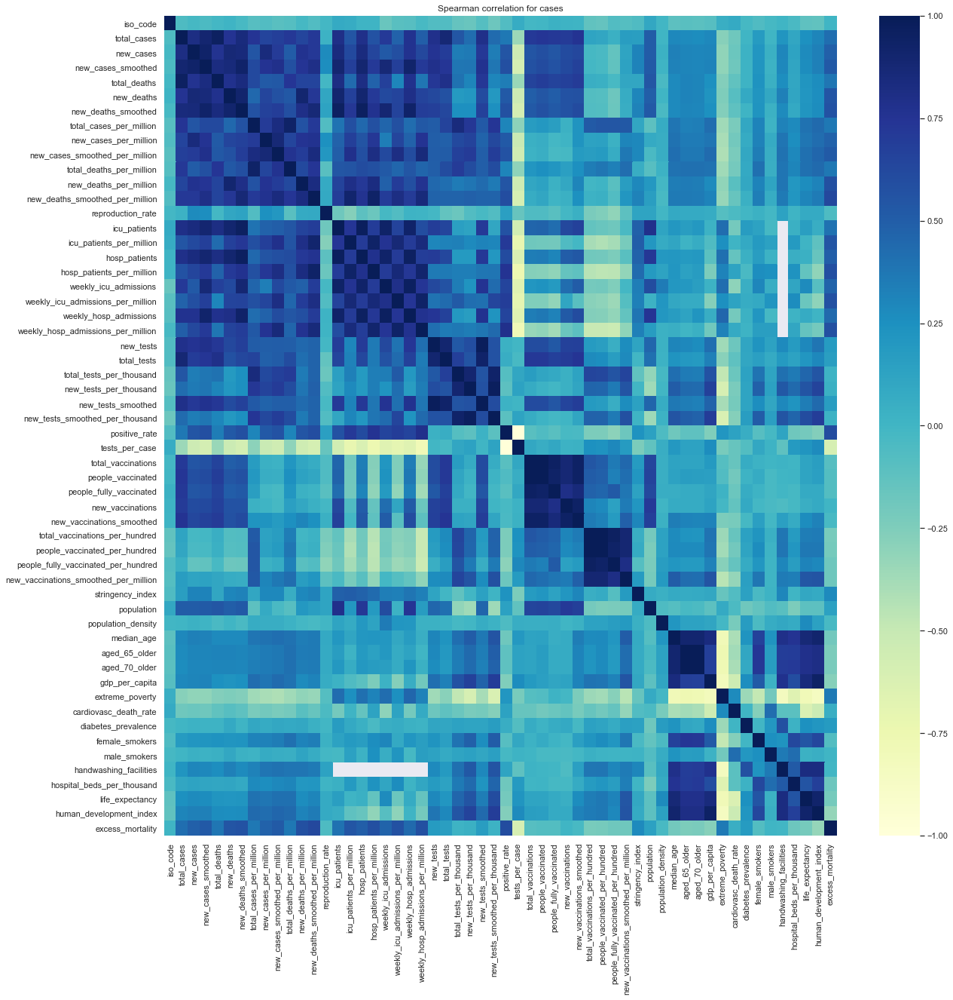

In [570]:
sns.set(rc={'figure.figsize':(20,8)})
# f, (ax1, ax2) = plt.subplots(1, 2)
plt.figure(figsize=(20,20))
owid2["iso_code"] = owid2["iso_code"].astype("category").cat.codes
# fatalities = train[train["Target"] == 0].drop(["Target"], axis=1)

corr = owid2.corr(method="spearman")
sns.heatmap(corr, vmin=-1, vmax=1, cmap="YlGnBu",set).set(title="Spearman correlation for cases");
plt.show()
# corr = fatalities.corr(method="spearman")
# plot = sns.heatmap(corr, vmin=-1, vmax=1, cmap="YlGnBu", ax=ax2).set(title="Spearman correlation for fatalities");

In [581]:
corr['new_cases']

iso_code                                -0.022052
total_cases                              0.818828
new_cases                                1.000000
new_cases_smoothed                       0.923190
total_deaths                             0.763064
new_deaths                               0.871004
new_deaths_smoothed                      0.858730
total_cases_per_million                  0.550105
new_cases_per_million                    0.848808
new_cases_smoothed_per_million           0.707924
total_deaths_per_million                 0.513272
new_deaths_per_million                   0.765831
new_deaths_smoothed_per_million          0.724358
reproduction_rate                        0.274667
icu_patients                             0.838805
icu_patients_per_million                 0.617757
hosp_patients                            0.839896
hosp_patients_per_million                0.647948
weekly_icu_admissions                    0.525169
weekly_icu_admissions_per_million        0.589619


In [573]:
corr['new_deaths']

iso_code                                 0.014285
total_cases                              0.757528
new_cases                                0.871004
new_cases_smoothed                       0.854554
total_deaths                             0.780308
new_deaths                               1.000000
new_deaths_smoothed                      0.913203
total_cases_per_million                  0.452761
new_cases_per_million                    0.642467
new_cases_smoothed_per_million           0.577802
total_deaths_per_million                 0.535182
new_deaths_per_million                   0.900361
new_deaths_smoothed_per_million          0.730521
reproduction_rate                        0.104947
icu_patients                             0.899638
icu_patients_per_million                 0.678706
hosp_patients                            0.903597
hosp_patients_per_million                0.713410
weekly_icu_admissions                    0.620926
weekly_icu_admissions_per_million        0.649787


In [583]:
corr['new_deaths_per_million']

iso_code                                -0.020832
total_cases                              0.646748
new_cases                                0.765831
new_cases_smoothed                       0.744451
total_deaths                             0.654067
new_deaths                               0.900361
new_deaths_smoothed                      0.800432
total_cases_per_million                  0.568031
new_cases_per_million                    0.752771
new_cases_smoothed_per_million           0.700484
total_deaths_per_million                 0.620989
new_deaths_per_million                   1.000000
new_deaths_smoothed_per_million          0.830691
reproduction_rate                        0.084489
icu_patients                             0.657869
icu_patients_per_million                 0.800128
hosp_patients                            0.721626
hosp_patients_per_million                0.830136
weekly_icu_admissions                    0.484705
weekly_icu_admissions_per_million        0.700429


In [582]:
corr['new_cases_per_million']

iso_code                                -0.065182
total_cases                              0.650841
new_cases                                0.848808
new_cases_smoothed                       0.755828
total_deaths                             0.516797
new_deaths                               0.642467
new_deaths_smoothed                      0.667883
total_cases_per_million                  0.704445
new_cases_per_million                    1.000000
new_cases_smoothed_per_million           0.867798
total_deaths_per_million                 0.647773
new_deaths_per_million                   0.752771
new_deaths_smoothed_per_million          0.766768
reproduction_rate                        0.243615
icu_patients                             0.476860
icu_patients_per_million                 0.687486
hosp_patients                            0.556973
hosp_patients_per_million                0.733188
weekly_icu_admissions                    0.338025
weekly_icu_admissions_per_million        0.643601


In [ ]:
sns.set(rc={'figure.figsize':(20,8)})
# f, (ax1, ax2) = plt.subplots(1, 2)
plt.figure(figsize=(20,20))
owid4= owid.drop
owid2.groupby(['iso_code','date'])
owid2["iso_code"] = owid2["iso_code"].astype("category").cat.codes
# fatalities = train[train["Target"] == 0].drop(["Target"], axis=1)

corr2 = oxcgrt.corr(method="spearman")
sns.heatmap(corr2, vmin=-1, vmax=1, cmap="YlGnBu").set(title="Spearman correlation for cases");
plt.show()
# corr = fatalities.corr(method="spearman")
# plot = sns.heatmap(corr, vmin=-1, vmax=1, cmap="YlGnBu", ax=ax2).set(title="Spearman correlation for fatalities");

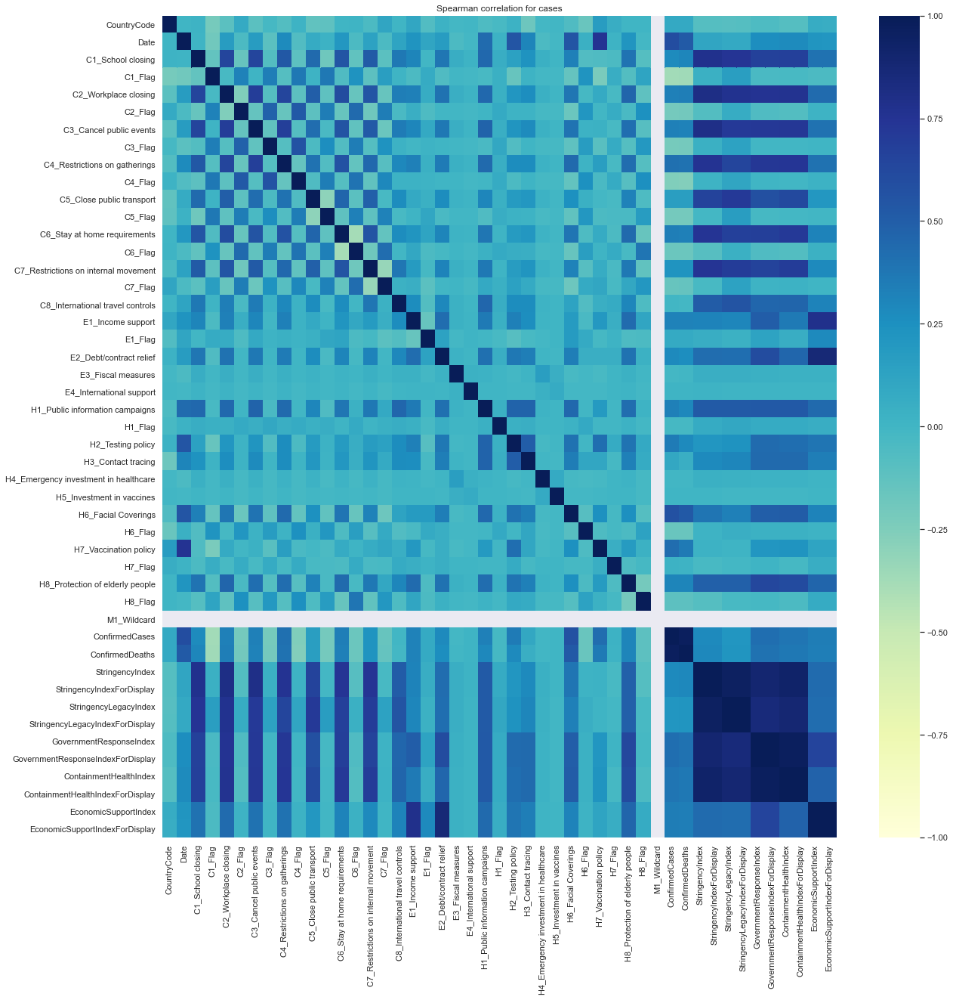

In [575]:
sns.set(rc={'figure.figsize':(20,8)})
# f, (ax1, ax2) = plt.subplots(1, 2)
plt.figure(figsize=(20,20))
oxcgrt["CountryCode"] = oxcgrt["CountryCode"].astype("category").cat.codes
# fatalities = train[train["Target"] == 0].drop(["Target"], axis=1)

corr2 = oxcgrt.corr(method="spearman")
sns.heatmap(corr2, vmin=-1, vmax=1, cmap="YlGnBu").set(title="Spearman correlation for cases");
plt.show()
# corr = fatalities.corr(method="spearman")
# plot = sns.heatmap(corr, vmin=-1, vmax=1, cmap="YlGnBu", ax=ax2).set(title="Spearman correlation for fatalities");

In [576]:
corr2['ConfirmedCases']

CountryCode                              0.086288
Date                                     0.594345
C1_School closing                        0.279812
C1_Flag                                 -0.374798
C2_Workplace closing                     0.335296
C2_Flag                                 -0.208235
C3_Cancel public events                  0.331690
C3_Flag                                 -0.216384
C4_Restrictions on gatherings            0.413639
C4_Flag                                 -0.255793
C5_Close public transport                0.162814
C5_Flag                                 -0.203731
C6_Stay at home requirements             0.340073
C6_Flag                                 -0.169924
C7_Restrictions on internal movement     0.229902
C7_Flag                                 -0.154068
C8_International travel controls        -0.007441
E1_Income support                        0.326501
E1_Flag                                  0.082189
E2_Debt/contract relief                  0.281909


In [579]:
corr2['ConfirmedDeaths']

CountryCode                              0.088321
Date                                     0.517106
C1_School closing                        0.300533
C1_Flag                                 -0.362609
C2_Workplace closing                     0.339855
C2_Flag                                 -0.202003
C3_Cancel public events                  0.327254
C3_Flag                                 -0.206693
C4_Restrictions on gatherings            0.401364
C4_Flag                                 -0.262384
C5_Close public transport                0.160167
C5_Flag                                 -0.207337
C6_Stay at home requirements             0.331102
C6_Flag                                 -0.171326
C7_Restrictions on internal movement     0.229312
C7_Flag                                 -0.148224
C8_International travel controls        -0.014956
E1_Income support                        0.322630
E1_Flag                                  0.082919
E2_Debt/contract relief                  0.265287


In [ ]:
from scipy import integrate, optimize


susceptible_0 = population - y_arr[0]
infected_0 = y_arr[0]

def sir(y,t,b,c,d):
    susceptible = -b * y[0] * y[1] / susceptible_0
    recovered = c * y[1]
    fatarities = d * y[1]
    infected = -(susceptible + recovered + fatarities)
    return susceptible,infected,recovered,fatarities

def inf_odeint(t,b,c,d):
    return integrate.odeint(sir,(susceptible_0,infected_0,0,0),t,args=(b,c,d))[:,1]

popt, pcov = optimize.curve_fit(inf_odeint, t_arr, y_arr)
fitted = inf_odeint(t_arr, *popt)

plt.plot(t_arr, y_arr, 'bo')
# plt.plot(np.append(t_arr,test_t_arr), fitted)
plt.plot(t_arr, fitted)

plt.title("Fit of infected model")
plt.ylabel("Population infected")
plt.xlabel("Days")
plt.show()

In [395]:
#sigmoid fitting
def sigmoid(t, M, beta, alpha, offset=0):
    alpha += offset
    return M / (1 + np.exp(-beta * (t - alpha)))

def error(x, y, params):
    M, beta, alpha = params
    y_pred = sigmoid(x, M, beta, alpha)

    # apply weight, latest number is more important than past.
    weight = np.arange(len(y_pred)) ** 2
    loss_mse = np.mean((y_pred - y) ** 2 * weight)
    return loss_mse

def gen_random_color(min_value=0, max_value=256) -> str:
    """Generate random color for plotly"""
    r, g, b = np.random.randint(min_value, max_value, 3)
    return f'rgb({r},{g},{b})'

def fit_sigmoid(exclude_days,target_date,var='new_cases'):
    target_country_df_list = []
    pred_df_list = []
    for target_country in country_list:
        print('target_country', target_country)
        # --- Train ---
        target_country_df = owid.query('iso_code == @target_country')

        #train_start_date = target_country_df['date'].min()
        train_start_date = target_country_df.query('new_cases > 1000')['date'].min()
        print(train_start_date)
        train_end_date = pd.to_datetime(target_date) - pd.Timedelta(f'{exclude_days} days')
        target_date_df = target_country_df.query('(date >= @train_start_date) & (date <= @train_end_date)')
        if len(target_date_df) <= 7:
            print('WARNING: the data is not enough, use 7 more days...')
            train_start_date -= pd.Timedelta('7 days')
            target_date_df = target_country_df.query('(date >= @train_start_date) & (date <= @train_end_date)')

        confirmed = target_date_df[var].values
        x = np.arange(len(confirmed))

        lossfun = lambda params: error(x, confirmed, params)
        res = sp.optimize.minimize(lossfun, x0=[np.max(confirmed) * 5, 0.04, 2 * len(confirmed) / 3.], method='nelder-mead')
        M, beta, alpha = res.x
        # sigmoid_models[key] = (M, beta, alpha)
        # np.clip(sigmoid(list(range(len(data), len(data) + steps)), M, beta, alpha), 0, None).astype(int)
        
        # --- Pred ---
        pred_start_date = target_country_df['date'].min()
        pred_end_date = pd.to_datetime('2021-12-31')
        days = int((pred_end_date - pred_start_date) / pd.Timedelta('1 days'))
        # print('pred start', pred_start_date, 'end', pred_end_date, 'days', days)

        x = np.arange(days)
        offset = (train_start_date - pred_start_date) / pd.Timedelta('1 days')
        print('train_start_date', train_start_date, 'offset', offset, 'params', M, beta, alpha)
        y_pred = sigmoid(x, M, beta, alpha, offset=offset)
        # target_country_df['confirmed_pred'] = y_pred

        all_dates = [pred_start_date + np.timedelta64(x, 'D') for x in range(days)]
        pred_df = pd.DataFrame({
            'date': all_dates,
            'country': target_country,
            'confirmed_pred': y_pred,
        })

        target_country_df_list.append(target_country_df)
        pred_df_list.append(pred_df)
    return target_country_df_list, pred_df_list

def plot_sigmoid_fitting(target_country_df_list, pred_df_list, title='',var='new_cases'):
    n_countries = len(country_list)

    # --- Plot ---
    fig = go.Figure()

    for i in range(n_countries):
        target_country = country_list[i]
        target_country_df = target_country_df_list[i]
        pred_df = pred_df_list[i]
        color = gen_random_color(min_value=20)
        # Prediction
        fig.add_trace(go.Scatter(
            x=pred_df['date'], y=pred_df['confirmed_pred'],
            name=f'{target_country}_pred',
            line=dict(color=color, dash='dash')
        ))

        # Ground truth
        fig.add_trace(go.Scatter(
            x=target_country_df['date'], y=target_country_df[var],
            mode='markers', name=f'{target_country}_actual',
            line=dict(color=color),
        ))
    fig.update_layout(
        title=title, xaxis_title='Date', yaxis_title='Confirmed cases')
    fig.show()

var = 'new_cases_smoothed'
target_country_df_list, pred_df_list = fit_sigmoid(0,target_date,var)
plot_sigmoid_fitting(target_country_df_list, pred_df_list, title='Sigmoid predicting',var=var)


target_country NLD
2020-03-26 00:00:00
train_start_date 2020-03-26 00:00:00 offset 28.0 params 6251.764582476735 0.17262357119055438 186.41607453989195
target_country IND
2020-04-06 00:00:00
train_start_date 2020-04-06 00:00:00 offset 67.0 params 32792.44144571211 0.13678232407870383 79.7677333389137
target_country USA
2020-03-16 00:00:00
train_start_date 2020-03-16 00:00:00 offset 54.0 params 161281.2016566701 0.0834891590659706 220.18230345530162
target_country BRA
2020-03-31 00:00:00
train_start_date 2020-03-31 00:00:00 offset 34.0 params 1031783.1952948724 0.003391611899961932 1206.3719398676556


In [393]:
#sigmoid fitting
def sigmoid(t, M, beta, alpha, offset=0):
    alpha += offset
    return M / (1 + np.exp(-beta * (t - alpha)))

def error(x, y, params):
    M, beta, alpha = params
    y_pred = sigmoid(x, M, beta, alpha)

    # apply weight, latest number is more important than past.
    weight = np.arange(len(y_pred)) ** 2
    loss_mse = np.mean((y_pred - y) ** 2 * weight)
    return loss_mse

def gen_random_color(min_value=0, max_value=256) -> str:
    """Generate random color for plotly"""
    r, g, b = np.random.randint(min_value, max_value, 3)
    return f'rgb({r},{g},{b})'

def fit_sigmoid(exclude_days,target_date,var='new_cases'):
    target_country_df_list = []
    pred_df_list = []
    for target_country in country_list:
        print('target_country', target_country)
        # --- Train ---
        target_country_df = owid.query('iso_code == @target_country')

        #train_start_date = target_country_df['date'].min()
        train_start_date = target_country_df.query('new_cases > 1000')['date'].min()
        print(train_start_date)
        train_end_date = pd.to_datetime(target_date) - pd.Timedelta(f'{exclude_days} days')
        target_date_df = target_country_df.query('(date >= @train_start_date) & (date <= @train_end_date)')
        if len(target_date_df) <= 7:
            print('WARNING: the data is not enough, use 7 more days...')
            train_start_date -= pd.Timedelta('7 days')
            target_date_df = target_country_df.query('(date >= @train_start_date) & (date <= @train_end_date)')

        confirmed = target_date_df[var].values
        x = np.arange(len(confirmed))

        lossfun = lambda params: error(x, confirmed, params)
        res = sp.optimize.minimize(lossfun, x0=[np.max(confirmed) * 5, 0.04, 2 * len(confirmed) / 3.], method='nelder-mead')
        M, beta, alpha = res.x
        # sigmoid_models[key] = (M, beta, alpha)
        # np.clip(sigmoid(list(range(len(data), len(data) + steps)), M, beta, alpha), 0, None).astype(int)
        
        # --- Pred ---
        pred_start_date = target_country_df['date'].min()
        pred_end_date = pd.to_datetime('2021-12-31')
        days = int((pred_end_date - pred_start_date) / pd.Timedelta('1 days'))
        # print('pred start', pred_start_date, 'end', pred_end_date, 'days', days)

        x = np.arange(days)
        offset = (train_start_date - pred_start_date) / pd.Timedelta('1 days')
        print('train_start_date', train_start_date, 'offset', offset, 'params', M, beta, alpha)
        y_pred = sigmoid(x, M, beta, alpha, offset=offset)
        # target_country_df['confirmed_pred'] = y_pred

        all_dates = [pred_start_date + np.timedelta64(x, 'D') for x in range(days)]
        pred_df = pd.DataFrame({
            'date': all_dates,
            'country': target_country,
            'confirmed_pred': y_pred,
        })

        target_country_df_list.append(target_country_df)
        pred_df_list.append(pred_df)
    return target_country_df_list, pred_df_list

def plot_sigmoid_fitting(target_country_df_list, pred_df_list, title='',var='new_cases'):
    n_countries = len(country_list)

    # --- Plot ---
    fig = go.Figure()

    for i in range(n_countries):
        target_country = country_list[i]
        target_country_df = target_country_df_list[i]
        pred_df = pred_df_list[i]
        color = gen_random_color(min_value=20)
        # Prediction
        fig.add_trace(go.Scatter(
            x=pred_df['date'], y=pred_df['confirmed_pred'],
            name=f'{target_country}_pred',
            line=dict(color=color, dash='dash')
        ))

        # Ground truth
        fig.add_trace(go.Scatter(
            x=target_country_df['date'], y=target_country_df[var],
            mode='markers', name=f'{target_country}_actual',
            line=dict(color=color),
        ))
    fig.update_layout(
        title=title, xaxis_title='Date', yaxis_title='Confirmed cases')
    fig.show()

var = 'new_cases_smoothed'
target_country_df_list, pred_df_list = fit_sigmoid(0,target_date,var)
plot_sigmoid_fitting(target_country_df_list, pred_df_list, title='Sigmoid predicting',var=var)


target_country AUT
2020-03-26 00:00:00
train_start_date 2020-03-26 00:00:00 offset 30.0 params 2628.9901641328984 0.20915770048439375 201.4929249372122
target_country BEL
2020-03-26 00:00:00
train_start_date 2020-03-26 00:00:00 offset 51.0 params 3577.0930230279073 0.23349361959032716 183.918213028956
target_country BGR
2020-10-19 00:00:00
train_start_date 2020-10-19 00:00:00 offset 225.0 params 121435.0313559727 -0.015131204992998762 -222.40902557538243
target_country HRV
2020-10-16 00:00:00
train_start_date 2020-10-16 00:00:00 offset 234.0 params 890.6163847980615 0.10316468351539815 -300.17747906250406
target_country CZE
2020-09-08 00:00:00
train_start_date 2020-09-08 00:00:00 offset 191.0 params 104751.20883397452 0.0036866995794174783 808.1867637160201
target_country DNK
2020-10-26 00:00:00
train_start_date 2020-10-26 00:00:00 offset 267.0 params 983.9793158071423 0.10841548041485224 -292.3321681228609
target_country EST
2021-01-07 00:00:00
train_start_date 2021-01-07 00:00:00 off

In [ ]:
def get_prediction_using_prophet(countryName):
    k = df1[df1['Country/Region']==countryName].loc[:,'1/22/20':]
    india_confirmed = k.values.tolist()[0] 
    data = pd.DataFrame(columns = ['ds','y'])
    data['ds'] = dates
    data['y'] = india_confirmed

    prop=Prophet()
    prop.fit(data)
    future=prop.make_future_dataframe(periods=30)
    prop_forecast=prop.predict(future)
    forecast = prop_forecast[['ds','yhat']].tail(30)

    fig = plot_plotly(prop, prop_forecast)
    fig = prop.plot(prop_forecast,xlabel='Date',ylabel='Confirmed Cases')
    
def get_prediction_using_ARIMA(countryName):
    k = df1[df1['Country/Region']==countryName].loc[:,'1/22/20':]
    india_confirmed = k.values.tolist()[0] 
    data = pd.DataFrame(columns = ['ds','y'])
    data['ds'] = dates
    data['y'] = india_confirmed
    arima = ARIMA(data['y'], order=(5, 1, 0))
    arima = arima.fit(trend='c', full_output=True, disp=True)
    forecast = arima.forecast(steps= 30)
    pred = list(forecast[0])

    start_date = data['ds'].max()
    prediction_dates = []
    for i in range(30):
        date = start_date + datetime.timedelta(days=1)
        prediction_dates.append(date)
        start_date = date
    plt.figure(figsize= (15,10))
    plt.xlabel("Dates",fontsize = 20)
    plt.ylabel('Total cases',fontsize = 20)
    title= "Predicted Values for the next 15 Days for "+countryName
    plt.title(title , fontsize = 20)

    plt.plot_date(y= pred,x= prediction_dates,linestyle ='dashed',color = '#ff9999',label = 'Predicted');
    plt.plot_date(y=data['y'],x=data['ds'],linestyle = '-',color = 'blue',label = 'Actual');
    plt.legend();

In [453]:
from datetime import date
startdate1 = date(2020, 12, 1)

Average growth factor 2.154281980008477
Average growth factor 2.04183517686709
Average growth factor 1.8088591355698993
Average growth factor 2.154281980008477


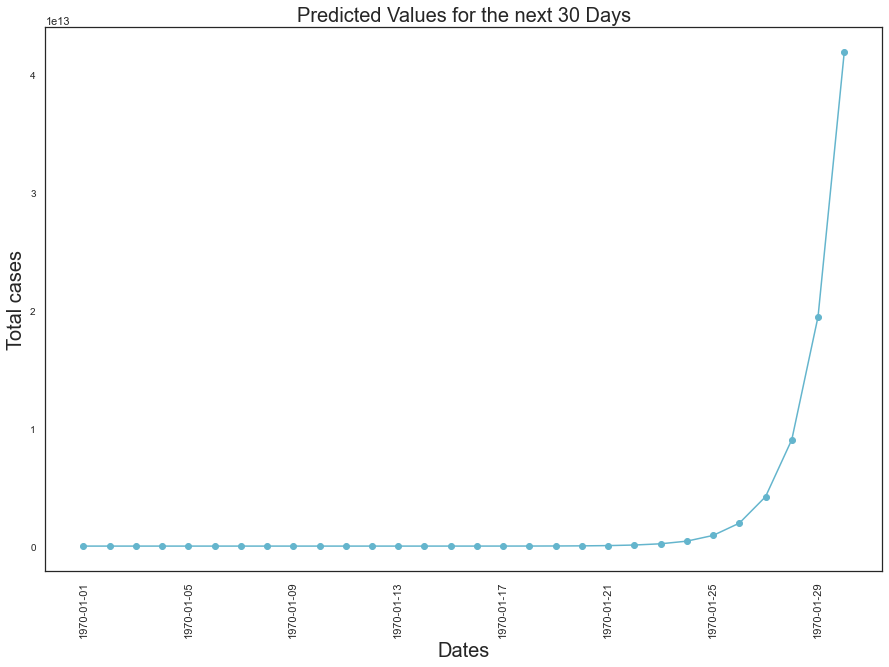

In [495]:
import datetime
startdate1 = '2020-12-01'
startdate2 = '2021-01-01'
startdate3 = '2021-04-01'
def growth_factor(startdate):
    growth_diff = []
    df_filtered = owid[owid.iso_code=='NLD']
    # df_filtered['date'] = pd.to_datetime(df_filtered['date'], format = '%Y-%m-%d').dt.date
    df_filtered1 = df_filtered[df_filtered['date']<startdate]['new_cases']
    for i in range(1,len(df_filtered1)):
        growth_diff.append(df_filtered1.iloc[i] / (df_filtered1.iloc[i-1]+1))

    growth_factor = sum(growth_diff)/len(growth_diff)
    print('Average growth factor',growth_factor)
    return growth_factor
growth_factor(startdate1)
growth_factor(startdate2)
growth_factor(startdate3)

def growth_factor_predict(startdate, days, growth_factor):
    predicted_cases,prediction_dates = [],[]
    df_filtered = owid[owid.iso_code=='NLD']
    previous_day_cases = df_filtered[df_filtered['date']==startdate]['new_cases']
    for i in range(days):
        predicted_value = previous_day_cases *  growth_factor
        predicted_cases.append(predicted_value)
        previous_day_cases = predicted_value
#         date = datetime.date(startdate) + datetime.timedelta(days=1)
#         prediction_dates.append(date)
#         start_date = date
    plt.figure(figsize= (15,10))
    plt.xticks(rotation = 90 ,fontsize = 11)
    plt.yticks(fontsize = 10)
    plt.xlabel("Dates",fontsize = 20)
    plt.ylabel('Total cases',fontsize = 20)
    plt.title(f"Predicted Values for the next {days} Days" , fontsize = 20)
#     print(predicted_cases,)
    ax1 = plt.plot_date(y= predicted_cases,x= range(days),linestyle ='-',color = 'c')
growth_factor_predict(startdate1, 30,growth_factor(startdate1))

In [493]:
datetime.date(startdate1) + datetime.timedelta(days=1)

TypeError: an integer is required (got type str)

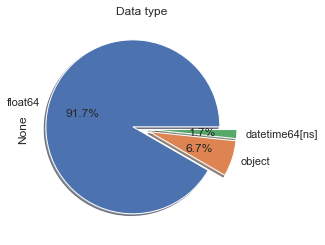

In [396]:
owid.dtypes.value_counts().plot.pie(explode=[0.1,0.1,0.1],autopct='%1.1f%%',shadow=True)
plt.title('Data type');

In [503]:
print(len(owid))
owid2=owid.dropna(subset=['new_cases_smoothed'])
len(owid2)

97992


93561

In [397]:
train = owid2.drop(['new_cases_per_million','total_cases','new_cases','new_cases_smoothed','total_cases_per_million','new_cases_smoothed_per_million',
                   'total_deaths','total_deaths_per_million',
                   'new_deaths','new_deaths_per_million',
                   'new_deaths_smoothed','new_deaths_smoothed_per_million','tests_units'],axis=True)

# train = owid['iso_code','continent','location','date','reproduction_rate','icu_patients','hosp_patients',
#             'new_tests','positive_rate'
#             ]


In [398]:
beginning = owid.date.min()
last = owid.date.max()

In [399]:
da= pd.to_datetime(train['date'])
train['date']= da.dt.strftime("%Y%m%d").astype(int)
train.fillna(0)
l = LabelEncoder()
X = train.iloc[:,0].values
train.iloc[:,0] = l.fit_transform(X.astype(str))
X = train.iloc[:,1].values
train.iloc[:,1] = l.fit_transform(X.astype(str))
X = train.iloc[:,2].values
train.iloc[:,2] = l.fit_transform(X.astype(str))
# print(train.date)
for i in range(3, len(train.columns)):
    X = train.iloc[:,i].values
    train.iloc[:,i]= l.fit_transform(X.astype(float))

In [400]:
train

,iso_code,continent,location,date,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,...,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality
5,0,1,0,32,2116,20410,23376,43567,47857,46804,...,35375,184,93,26136,27089,38,4,34,15,46799
6,0,1,0,33,6431,57131,60097,57805,62095,62321,...,9662,184,93,6348,7274,38,4,34,15,62116
7,0,1,0,34,6430,57130,60096,57804,62094,62320,...,9661,184,93,6349,7275,38,4,34,15,62115
8,0,1,0,35,6429,57129,60095,57803,62093,62319,...,9660,184,93,6350,7276,38,4,34,15,62114
9,0,1,0,36,6428,57128,60094,57802,62092,62318,...,9659,184,93,6351,7277,38,4,34,15,62113
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97987,200,0,200,509,190,27789,30755,28745,33035,15892,...,43,128,1,14,56,37,20,17,33,31437
97988,200,0,200,510,191,27788,30754,28744,33034,15879,...,43,128,1,14,56,37,20,17,33,31436
97989,200,0,200,511,191,27787,30753,28743,33033,15886,...,43,128,1,14,56,37,20,17,33,31435
97990,200,0,200,512,12021,74488,77454,74535,78825,78004,...,43,128,1,14,56,37,20,17,33,78177


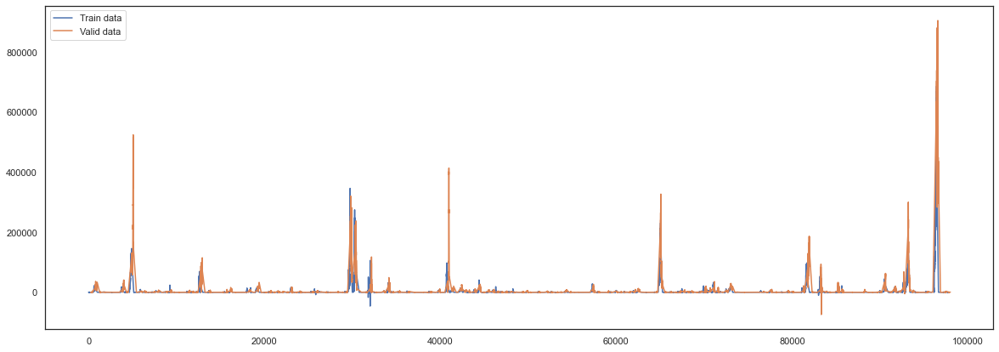

In [504]:
train=owid2[owid2['date']<startdate1]
valid=owid2[owid2['date']>startdate1]
plt.figure(figsize=(20,7))

train.new_cases.plot(label='Train data')
valid.new_cases.plot(label='Valid data')
plt.legend(loc='best')

<ipython-input-507-fc9a301cb247>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



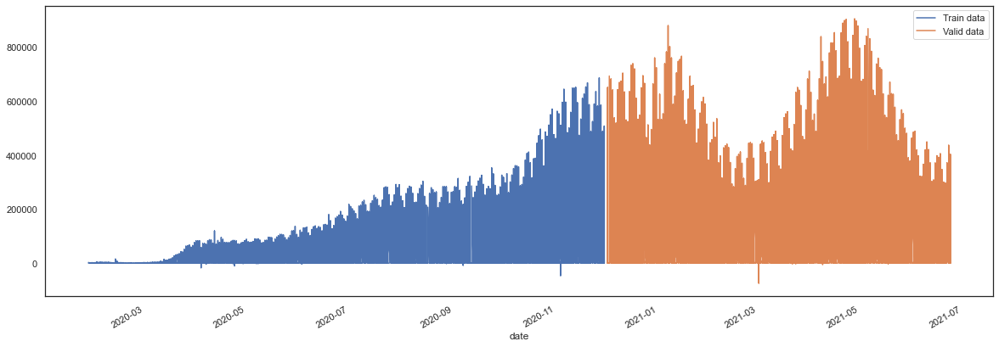

In [507]:
train_df = owid2

train_df.index=train_df.date
df_filtered['date'] = pd.to_datetime(df_filtered['date'], format = '%Y-%m-%d')
train=owid2[owid2['date']<startdate1]
valid=owid2[owid2['date']>startdate1]
plt.figure(figsize=(20,7))

train.new_cases.plot(label='Train data')
valid.new_cases.plot(label='Valid data')
plt.legend(loc='best')

In [510]:
from statsmodels.tsa.stattools import adfuller
dftest=adfuller(train.new_cases.dropna(), autolag='AIC')
dfout=pd.Series(dftest[0:4], index=['Test statistics', 'p-value', '#Lags used', 'Number of observation used'])
for key, val in dftest[4].items():
    dfout['Critical value (%s)'%key]=val

print(dfout)
# When running a linear regression the assumption is that all of the observations are all independent of each 
#other. In a time series, however, we know that observations are time dependent. 
#It turns out that a lot of nice results that hold for independent random variables 
#(law of large numbers and central limit theorem to name a couple) hold for stationary random variables. 
#So by making the data stationary, we can actually apply regression techniques to this time dependent variable.


#For a more accurate assessment there is the Dickey-Fuller test. 
#The smaller p-value, the more likely it's stationary.
#To get a stationary data, there's many techiniques. We can use log, differencing etc...
#Augmented Dickey–Fuller test is the most accepted determination of stationarity in the literature and it is accepted as the most valid test in determining stationarity in time series.


Test statistics              -1.433194e+01
p-value                       1.096125e-26
#Lags used                    5.700000e+01
Number of observation used    5.232500e+04
Critical value (1%)          -3.430475e+00
Critical value (5%)          -2.861595e+00
Critical value (10%)         -2.566799e+00
dtype: float64


In [ ]:
# #AR model might be investigated first with lag length selected from the PACF or via empirical investigation. In our case, it's clearly that within 4 lags the AR is significant. Which means, we can use AR = 4

# To avoid the potential for incorrectly specifying the MA order (in the case where the MA is first tried then the MA order is being set to 0), it may often make sense to extend the lag observed from the last significant term in the PACF.

# What is interesting is that when the AR model is appropriately specified, the the residuals from this model can be used to directly observe the uncorrelated error. This residual can be used to further investigate alternative MA and ARMA model specifications directly by regression.

# Assuming an AR(s) model were computed, then I would suggest that the next step in identification is to estimate an MA model with s-1 lags in the uncorrelated errors derived from the regression. The parsimonious MA specification might be considered and this might be compared with a more parsimonious AR specification. Then ARIMA models might also be analysed.

In [ ]:
#Inefficiency: ARIMA needs to be run on each time series, since we have 500 store/item combinations, 
#it needs to run 500 times. Every time we want to forecast the future, say on Jan 2, 2018, 
#we want to forecast next 90 days. We need to re-run ARIMA

#Intepretability: Each coefficient means a specific thing ts key elements understanding: the concept of lags,
#and error lag terms are very unique, ARIMA gave a comprehensive cover on them. So even in the future I want to try some other regression model. 
#I would add the lag terms and consider the error term.

In [401]:
# Split datasets
y_train=owid2['new_cases_smoothed']
x_train=train
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=0.3, random_state=0)

In [402]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
# Split datasets
y_train=owid2['new_cases_smoothed']
x_train=train
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=0.3, random_state=0)

model = Pipeline([('poly', PolynomialFeatures(degree=2)),
                 ('linear', LinearRegression(fit_intercept=False))])
# model = LinearRegression()
model.fit(x_train , y_train)
prediction = model.predict(x_test)
acc=model.score(x_test,y_test)
print(acc)
pip = Pipeline([('scaler2' , StandardScaler()),
                        ('ExtraTreesRegressor: ', ExtraTreesRegressor(n_estimators=5))]) # On competition I set n_estimators=500
pip.fit(x_train , y_train)
prediction = pip.predict(x_test)
acc=pip.score(x_test,y_test)
print(acc)

0.7935596725587049
0.9976820566695294


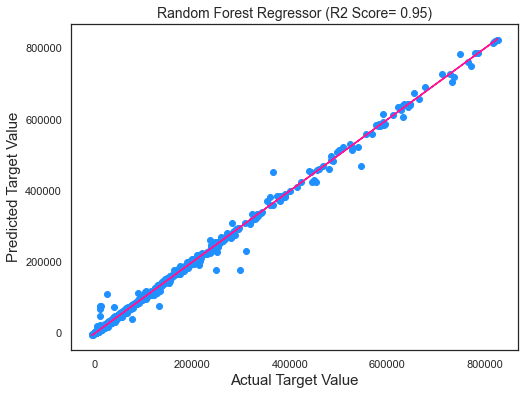

In [405]:
plt.figure(figsize=(8,6))
plt.plot(y_test,y_test,color='deeppink')
plt.scatter(y_test,prediction,color='dodgerblue')
plt.xlabel('Actual Target Value',fontsize=15)
plt.ylabel('Predicted Target Value',fontsize=15)
plt.title('Random Forest Regressor (R2 Score= 0.95)',fontsize=14)
plt.show()

In [404]:
import xgboost as xgb
model = xgb.XGBRegressor(n_jobs=-1, n_estimators=50)
eval_set = [(x_test, y_test)]
model.fit(x_train, y_train, early_stopping_rounds=10, eval_metric="mae", eval_set=eval_set, verbose=True)
score = model.score(X_test, y_test)
print("Score: "+ str(score))

XGBoostError: XGBoost Library (libxgboost.dylib) could not be loaded.
Likely causes:
  * OpenMP runtime is not installed (vcomp140.dll or libgomp-1.dll for Windows, libomp.dylib for Mac OSX, libgomp.so for Linux and other UNIX-like OSes). Mac OSX users: Run `brew install libomp` to install OpenMP runtime.
  * You are running 32-bit Python on a 64-bit OS
Error message(s): ['dlopen(/Users/mac/opt/anaconda3/lib/python3.8/site-packages/xgboost/lib/libxgboost.dylib, 6): Library not loaded: /usr/local/opt/libomp/lib/libomp.dylib\n  Referenced from: /Users/mac/opt/anaconda3/lib/python3.8/site-packages/xgboost/lib/libxgboost.dylib\n  Reason: image not found']


In [ ]:
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def evaluate(df):
    error = 0
    for col in TARGETS:
        error += rmse(df[col].values, df["pred_{}".format(col)].values)
    return np.round(error/len(TARGETS), 5)


def predict(test_df, first_day, num_days, val=False):

    y_pred = np.clip(model.predict(test_df.loc[test_df["Date"] == first_day][features]), None, 16)

    for i, col in enumerate(TARGETS):
        test_df["pred_{}".format(col)] = 0
        test_df.loc[test_df["Date"] == first_day, "pred_{}".format(col)] = y_pred[:, i]

    if val:
        print(first_day, evaluate(test_df[test_df["Date"] == first_day]))

    for d in range(1, num_days):
        y_pred = np.clip(model.predict(y_pred), None, 16)
        date = first_day + timedelta(days=d)

        for i, col in enumerate(TARGETS):
            test_df.loc[test_df["Date"] == date, "pred_{}".format(col)] = y_pred[:, i]

        if val:
            print(date, evaluate(test_df[test_df["Date"] == date]))
        
    return test_df

test_df = predict(test_df, TEST_FIRST, TEST_DAYS, val=True)
evaluate(test_df)

In [243]:
x_train.isnull().sum()
x_train.isnull().sum()


iso_code                                 0
continent                                0
location                                 0
date                                     0
reproduction_rate                        0
icu_patients                             0
icu_patients_per_million                 0
hosp_patients                            0
hosp_patients_per_million                0
weekly_icu_admissions                    0
weekly_icu_admissions_per_million        0
weekly_hosp_admissions                   0
weekly_hosp_admissions_per_million       0
new_tests                                0
total_tests                              0
total_tests_per_thousand                 0
new_tests_per_thousand                   0
new_tests_smoothed                       0
new_tests_smoothed_per_thousand          0
positive_rate                            0
tests_per_case                           0
total_vaccinations                       0
people_vaccinated                        0
people_full

In [264]:
#The difference between these are
##Usually demand prediction have more regular cycle, it continues. However corona virus has "start" and "end" in its spread.
##Enough data are provided in demand prediction, e.g., 1 year data, while corona virus spread is on-going phenomena and we have few data.

In [349]:
new_cases_deaths = owid[['date','iso_code','new_cases','new_deaths']]
df_trend = owid.groupby(['date','iso_code'], as_index=False)[['new_cases','new_deaths']].sum()
df_trend = df_trend


In [352]:
owid.iso_code.unique()

array(['AFG', 'OWID_AFR', 'ALB', 'DZA', 'AND', 'AGO', 'AIA', 'ATG', 'ARG',
       'ARM', 'ABW', 'OWID_ASI', 'AUS', 'AUT', 'AZE', 'BHS', 'BHR', 'BGD',
       'BRB', 'BLR', 'BEL', 'BLZ', 'BEN', 'BMU', 'BTN', 'BOL', 'BES',
       'BIH', 'BWA', 'BRA', 'VGB', 'BRN', 'BGR', 'BFA', 'BDI', 'KHM',
       'CMR', 'CAN', 'CPV', 'CYM', 'CAF', 'TCD', 'CHL', 'CHN', 'COL',
       'COM', 'COG', 'COK', 'CRI', 'CIV', 'HRV', 'CUB', 'CUW', 'CYP',
       'CZE', 'COD', 'DNK', 'DJI', 'DMA', 'DOM', 'ECU', 'EGY', 'SLV',
       'GNQ', 'ERI', 'EST', 'SWZ', 'ETH', 'OWID_EUR', 'OWID_EUN', 'FRO',
       'FLK', 'FJI', 'FIN', 'FRA', 'PYF', 'GAB', 'GMB', 'GEO', 'DEU',
       'GHA', 'GIB', 'GRC', 'GRL', 'GRD', 'GTM', 'GGY', 'GIN', 'GNB',
       'GUY', 'HTI', 'HND', 'HKG', 'HUN', 'ISL', 'IND', 'IDN', 'OWID_INT',
       'IRN', 'IRQ', 'IRL', 'IMN', 'ISR', 'ITA', 'JAM', 'JPN', 'JEY',
       'JOR', 'KAZ', 'KEN', 'KIR', 'OWID_KOS', 'KWT', 'KGZ', 'LAO', 'LVA',
       'LBN', 'LSO', 'LBR', 'LBY', 'LIE', 'LTU', 'LUX', 'MAC', 'MDG

In [350]:
px.line(df_trend, x='date', y='new_cases', color='iso_code', title='COVID19 Total Cases growth for top 20 worst affected countries')

In [331]:
last_date = new_cases_deaths.date.max()
df_countries = new_cases_deaths[new_cases_deaths['date']==last_date]
df_countries = df_countries.groupby('iso_code', as_index=False)['new_cases'].sum()
newdeaths_countries = df_countries.groupby('iso_code', as_index=False)['new_deaths'].sum()

df_trend = owid.groupby(['date','iso_code'], as_index=False)['new_cases'].sum()
# df_trend = df_trend.merge(df_countries, on='iso_code')
# df_trend = df_trend.merge(newdeaths_countries, on='iso_code')

df_trend.rename(columns={'iso_code':'Country', 'new_cases_x':'Cases'}, inplace=True)

df_trend.plot()

KeyError: 'Column not found: new_deaths'

In [177]:
# Find date start COVID19 growth
country_list = df_trend['Country'].unique()
country_stage = pd.DataFrame(columns = ['Country', 'COVID_start', 'COVID_max', 'COVID_now'])
for i in range(len(country_list)):
    country_i = df_trend[df_trend['Country'] == country_list[i]].reset_index(drop=True)
    country_stage.loc[i,'Country'] = country_list[i]                                                    # country name
    country_stage.loc[i,'COVID_start'] = country_i[country_i['Cases']!=0]['Cases'].cumsum().idxmin()    # date of the first cases
    country_stage.loc[i,'COVID_max'] = np.argmax(country_i['Cases'])                                    # date of the maximum
    country_stage.loc[i,'COVID_now'] = country_i.Cases[len(country_i)-1]/country_i.Cases.max()          # % from maximum at the end date

Cases now as % from maximum in each country


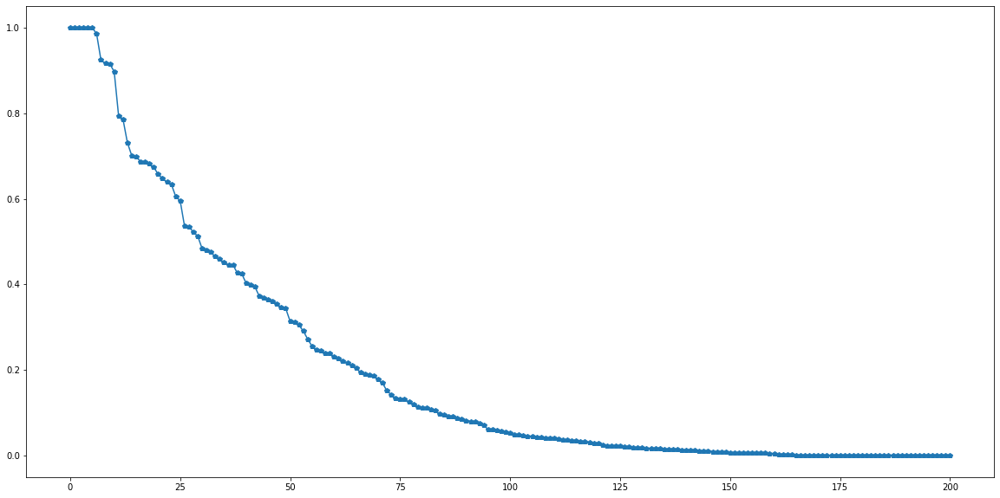

In [188]:
country_stage_now = country_stage[['Country','COVID_now', 'COVID_max']].sort_values(by='COVID_now', ascending=False)
print("Cases now as % from maximum in each country")
plt.figure(figsize=(20,10))
plt.plot(range(len(country_stage_now.Country)), country_stage_now.COVID_now, marker='p');

In [195]:
country_stage

,Country,COVID_start,COVID_max,COVID_now
0,ARG,62,512,0.595497
1,MEX,58,278,0.189934
2,THA,20,499,0.426362
3,DEU,3,341,0.00968518
4,EST,24,402,0.00920245
...,...,...,...,...
196,MHL,8,20,0
197,VUT,0,118,0
198,WSM,0,0,0
199,FSM,0,0,0


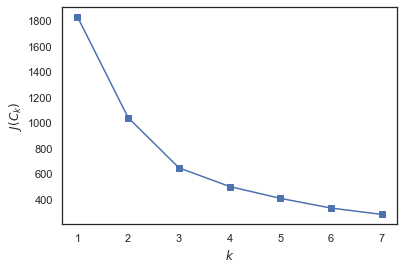

In [192]:

data = country_stage[['COVID_start', 'COVID_max', 'COVID_now']]
inertia = []
pca = PCA(n_components=2)
# fit X and apply the reduction to X 
x_3d = pca.fit_transform(data)
#x_3d=data
for k in range(1, 8):
    kmeans = KMeans(n_clusters=k, random_state=1).fit(x_3d)
    inertia.append(np.sqrt(kmeans.inertia_))
plt.plot(range(1, 8), inertia, marker='s');
plt.xlabel('$k$')
plt.ylabel('$J(C_k)$');

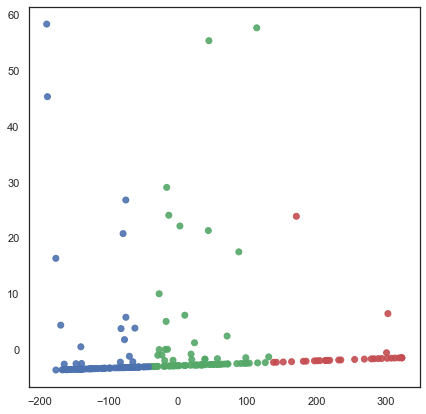

In [194]:
# Set a 3 KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=0)
# Compute cluster centers and predict cluster indices
X_clustered = kmeans.fit_predict(x_3d)
LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'g',
                   2 : 'b'}

label_color = [LABEL_COLOR_MAP[l] for l in X_clustered]
plt.figure(figsize = (7,7))
plt.scatter(x_3d[:,0],x_3d[:,1], c= label_color, alpha=0.9)
plt.show()

In [198]:
px.line(df_trend, x='date', y='Cases', color='Country', title='COVID19 Total Cases growth for top 20 (without USA) worst affected countries')

In [197]:
y_train=train['TargetValue']
x_train=train.drop(['TargetValue'],axis=1)
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=0.2, random_state=0)

,date,Country,Cases,new_cases_y
0,2020-01-01,ARG,0.0,24463.0
1,2020-01-02,ARG,0.0,24463.0
2,2020-01-03,ARG,0.0,24463.0
3,2020-01-04,ARG,0.0,24463.0
4,2020-01-05,ARG,0.0,24463.0
...,...,...,...,...
95119,2021-06-20,KIR,0.0,0.0
95120,2021-06-21,KIR,0.0,0.0
95121,2021-06-22,KIR,0.0,0.0
95122,2021-06-23,KIR,0.0,0.0


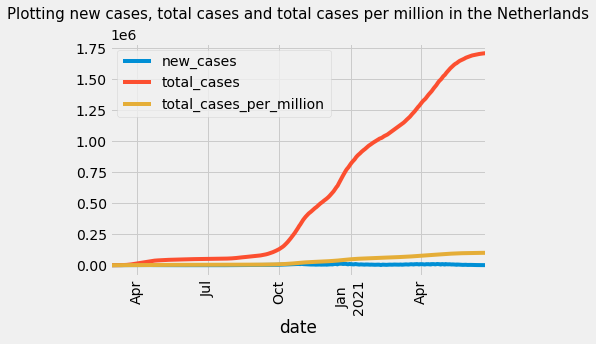

In [141]:
df_trend = owid.sort_values('date', ascending=True)
df['date'] = pd.to_datetime(df['date'], format = '%Y-%m-%d')
owid.tail(20)

df_filtered = df[df.iso_code=='NLD']
with plt.style.context('fivethirtyeight'):
    df_filtered = df[df.iso_code=='NLD']
    df_filtered.plot(x="date", y=["new_cases", "total_cases", "total_cases_per_million"])
    plt.xticks(rotation=90)
    plt.title('Plotting new cases, total cases and total cases per million in the Netherlands\n', size=15);
    plt.show()

In [149]:
df_filtered['icu_patients']

62211      7.0
62212      8.0
62213      9.0
62214     11.0
62215     10.0
         ...  
62690    201.0
62691      NaN
62692      NaN
62693      NaN
62694      NaN
Name: icu_patients, Length: 484, dtype: float64

In [ ]:
df_filtered['new_cases','new_deaths','reproduction_rate','icu_patients','hosp_patients','weekly_icu_admissions','total_tests']

In [145]:
df_filtered.corr().style.background_gradient()


/Users/mac/opt/anaconda3/lib/python3.8/site-packages/pandas/io/formats/style.py:1126: RuntimeWarning: All-NaN slice encountered
  smin = np.nanmin(s.to_numpy()) if vmin is None else vmin
/Users/mac/opt/anaconda3/lib/python3.8/site-packages/pandas/io/formats/style.py:1127: RuntimeWarning: All-NaN slice encountered
  smax = np.nanmax(s.to_numpy()) if vmax is None else vmax


,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,new_tests,total_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,new_vaccinations_smoothed_per_million,stringency_index,population,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality
total_cases,1.000000,0.504725,0.542103,0.964262,-0.052474,-0.030361,1.000000,0.504725,0.542103,0.964262,-0.052477,-0.030351,-0.371146,0.383900,0.383900,0.335063,0.335063,0.335520,0.335524,0.388034,0.388034,nan,0.986506,0.986506,nan,0.644352,0.644349,0.092097,-0.368922,0.933605,0.957775,0.863999,nan,0.933169,0.933612,0.957767,0.864070,0.933170,0.457943,nan,0.000000,0.000000,0.000000,-0.000000,-0.000000,nan,0.000000,0.000000,0.000000,0.000000,nan,0.000000,0.000000,0.000000,-0.153781
new_cases,0.504725,1.000000,0.975612,0.508720,0.239612,0.252057,0.504725,1.000000,0.975612,0.508720,0.239611,0.252066,-0.090549,0.433373,0.433373,0.534663,0.534663,0.592122,0.592122,0.736997,0.736998,nan,0.594575,0.594575,nan,0.801956,0.801940,0.396948,-0.485632,-0.614356,-0.574094,-0.688136,nan,-0.410749,-0.614343,-0.574070,-0.688035,-0.410744,0.410543,nan,0.000000,0.000000,0.000000,0.000000,0.000000,nan,0.000000,-0.000000,-0.000000,-0.000000,nan,0.000000,0.000000,-0.000000,0.154488
new_cases_smoothed,0.542103,0.975612,1.000000,0.545629,0.268867,0.283283,0.542103,0.975612,1.000000,0.545629,0.268867,0.283291,-0.148105,0.460099,0.460099,0.561540,0.561540,0.597559,0.597559,0.750220,0.750220,nan,0.643347,0.643346,nan,0.796991,0.796978,0.405576,-0.496817,-0.569249,-0.519751,-0.649329,nan,-0.401406,-0.569239,-0.519725,-0.649239,-0.401406,0.428779,nan,0.000000,-0.000000,-0.000000,0.000000,0.000000,nan,-0.000000,-0.000000,-0.000000,0.000000,nan,0.000000,-0.000000,-0.000000,0.154125
total_deaths,0.964262,0.508720,0.545629,1.000000,-0.117166,-0.090630,0.964262,0.508720,0.545630,1.000000,-0.117169,-0.090623,-0.469129,0.261334,0.261335,0.206025,0.206025,0.210067,0.210071,0.284216,0.284216,nan,0.967602,0.967602,nan,0.691761,0.691756,-0.078927,-0.269799,0.817104,0.846426,0.783021,nan,0.840545,0.817111,0.846399,0.783130,0.840545,0.428466,nan,0.000000,0.000000,0.000000,0.000000,0.000000,nan,0.000000,-0.000000,0.000000,-0.000000,nan,-0.000000,0.000000,-0.000000,-0.281897


In [64]:
df_neu = df_filtered[df_filtered.date>'2021-04-01']

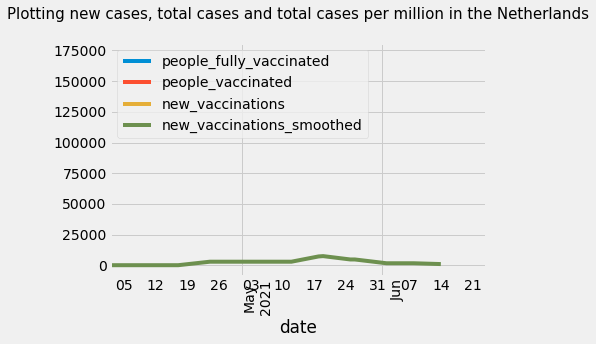

In [65]:
# df_filtered = df[df.iso_code=='NER']
with plt.style.context('fivethirtyeight'):
#     df_filtered = df[df.iso_code=='NER']
    df_neu.plot(x="date", y=['people_fully_vaccinated','people_vaccinated','new_vaccinations','new_vaccinations_smoothed'])
    plt.xticks(rotation=90)
    plt.title('Plotting new cases, total cases and total cases per million in the Netherlands\n', size=15);
    plt.show()

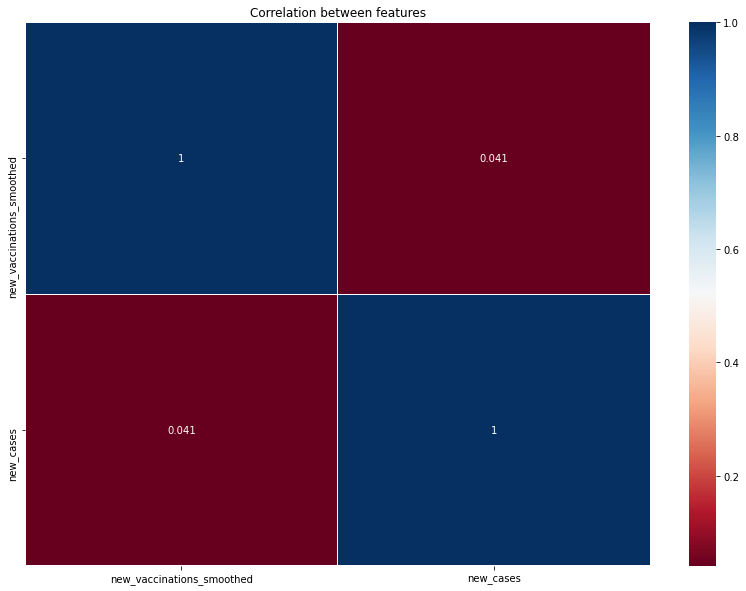

In [69]:
data= df_neu[['new_vaccinations_smoothed','new_cases']]
f, ax= plt.subplots(figsize = (14, 10))

corr = data.corr()
# print(corr)
sns.heatmap(corr,cmap='RdBu', linewidths = 0.05, ax = ax,annot=True)

# 设置Axes的标题
ax.set_title('Correlation between features')
plt.show()

In [71]:
df_neu.corr()[['new_vaccinations_smoothed']]

,new_vaccinations_smoothed
total_cases,5.370875e-01
new_cases,4.071683e-02
new_cases_smoothed,-5.767517e-02
total_deaths,6.601486e-01
new_deaths,-2.179274e-01
new_deaths_smoothed,-5.627690e-01
total_cases_per_million,5.370858e-01
new_cases_per_million,4.074593e-02
new_cases_smoothed_per_million,-5.759410e-02
total_deaths_per_million,6.599604e-01


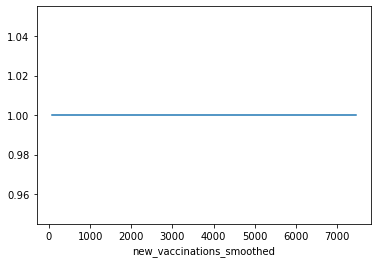

In [95]:
import scipy 

data = df_neu['new_vaccinations_smoothed']
norm = scipy.stats.norm.cdf(data.dropna())
sns.lineplot(x=data.dropna(),y=norm)
plt.show()
# df_neu[['new_cases','new_vaccinations_smoothed']].plot()

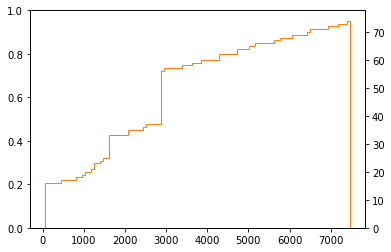

In [99]:
fig, ax = plt.subplots()
ax2 = ax.twinx()
# n, bins, patches = ax.hist(data, bins=100)
n, bins, patches = ax2.hist(
    data, cumulative=1, histtype='step', bins=100, color='tab:orange')

<ipython-input-125-2397b97ce092>:6: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  counts, bin_edges = np.histogram(data, bins=num_bins, normed=True)
<ipython-input-125-2397b97ce092>:9: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  counts, bin_edges = np.histogram(data, bins=num_bins, normed=True)


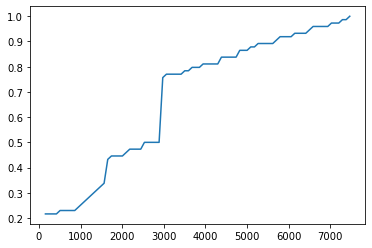

In [125]:
import numpy as np
num_bins = 84
data = df_neu['new_vaccinations_smoothed']
# data1 = df_num['total']
data =data.dropna()
counts, bin_edges = np.histogram(data, bins=num_bins, normed=True)
# Choose how many bins you want here
# Use the histogram function to bin the data
counts, bin_edges = np.histogram(data, bins=num_bins, normed=True)
pdf = counts/sum(counts)
# Now find the cdf
cdf = np.cumsum(pdf)

# And finally plot the cdf
plt.plot(bin_edges[1:], cdf)

plt.show()
# counts, bin_edges = np.histogram(data, bins=num_bins, normed=True)
# # Choose how many bins you want here
# # Use the histogram function to bin the data
# counts, bin_edges = np.histogram(data, bins=num_bins, normed=True)
# pdf = counts/sum(counts)
# # Now find the cdf
# cdf = np.cumsum(pdf)

# # And finally plot the cdf
# plt.plot(bin_edges[1:], cdf)

# plt.show()

In [127]:
# len(df_neu['total_cases'])
# len(df_neu[''])
len(cdf)
np.corrcoef(df_neu['total_cases'],cdf)

array([[1.        , 0.98712209],
       [0.98712209, 1.        ]])

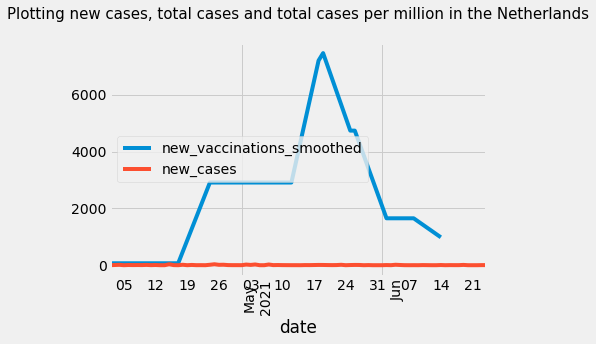

In [77]:
 # df_filtered = df[df.iso_code=='NER']
with plt.style.context('fivethirtyeight'):
#     df_filtered = df[df.iso_code=='NER']
    df_neu.plot(x="date", y=['new_vaccinations_smoothed','new_cases'])
    plt.xticks(rotation=90)
    plt.title('Plotting new cases, total cases and total cases per million in the Netherlands\n', size=15);
    plt.show()

In [78]:
df_neu['new_cases']

64159     0.0
64160     7.0
64161    13.0
64162     0.0
64163     7.0
         ... 
64238     0.0
64239     0.0
64240     0.0
64241     3.0
64242     3.0
Name: new_cases, Length: 84, dtype: float64

In [138]:
train1.groupby(owid['iso_code']).sum()

iso_code
ABW          0.0
AFG     109532.0
AGO      38091.0
AIA          0.0
ALB     132499.0
         ...    
WSM          3.0
YEM       6905.0
ZAF    1877143.0
ZMB     140620.0
ZWE      44306.0
Name: new_cases, Length: 230, dtype: float64

Text(0.5, 1.0, 'Covid Cases Top 30')

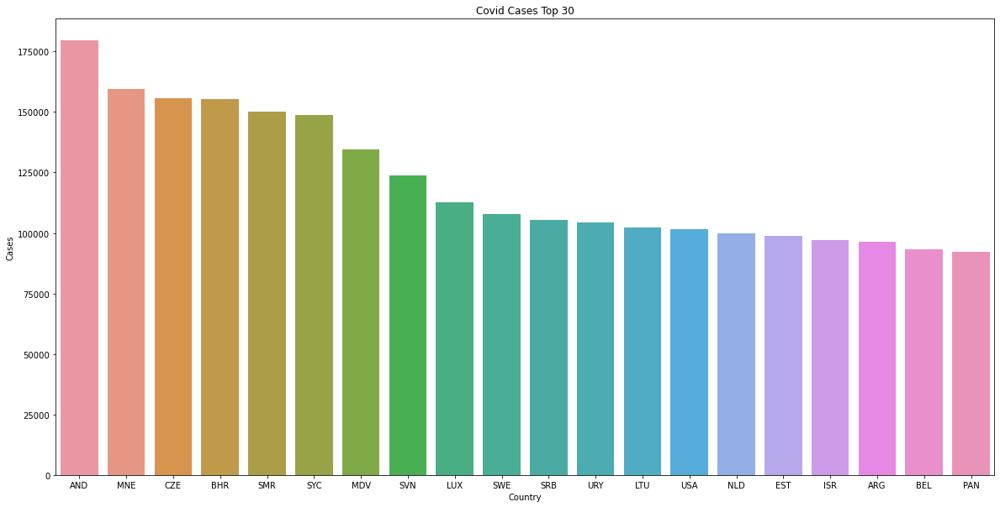

In [152]:
train1 = owid['new_cases_per_million']
data1 = pd.DataFrame()
data1['values'] =train1.groupby(owid['iso_code']).sum().sort_values(ascending= False)
data1['country'] = data1.index
data1.index = np.arange(0,len(data1))
data10 = data1.iloc[0:20,:]
# data20 = data1.iloc[11:20,:]
plt.figure(figsize =(20,10))
# plt.subplot(2,1,1)
sns.barplot(x='country', y='values', data=data10, orient ='v')
plt.xlabel('Country')
plt.ylabel('Cases')
plt.title('Covid Cases Top 30')
# plt.subplot(2,1,2)
# sns.barplot(x='country', y='values', data=data20, orient ='v')
# plt.xlabel('Country')
# plt.ylabel('Cases')
# plt.title('Covid Cases Next 10')

Text(0.5, 1.0, 'Covid Cases Top 20')

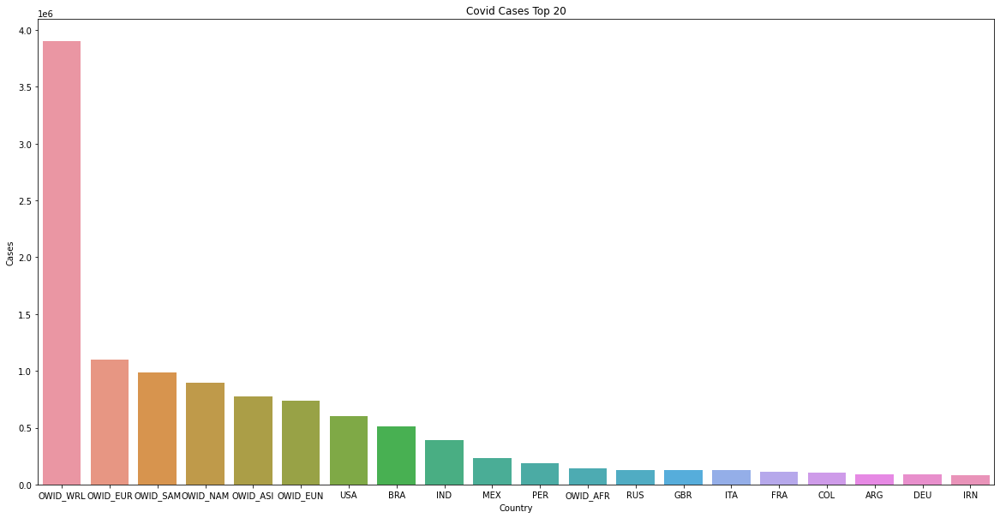

In [139]:
train1 = owid['new_deaths']
data1 = pd.DataFrame()
data1['values'] =train1.groupby(owid['iso_code']).sum().sort_values(ascending= False)
data1['country'] = data1.index
data1.index = np.arange(0,len(data1))
data10 = data1.iloc[0:30,:]
# data20 = data1.iloc[11:20,:]
plt.figure(figsize =(20,10))
# plt.subplot(2,1,1)
sns.barplot(x='country', y='values', data=data10, orient ='v')
plt.xlabel('Country')
plt.ylabel('Cases')
plt.title('Covid Deaths Top 20')
# plt.subplot(2,1,2)
# sns.barplot(x='country', y='values', data=data20, orient ='v')
# plt.xlabel('Country')
# plt.ylabel('Cases')
# plt.title('Covid Cases Next 10')

In [140]:
df = owid.sort_values('date', ascending=True)
df['date'] = pd.to_datetime(df['date'], format = '%Y-%m-%d')
df_filtered = df[df.iso_code=='NLD']
df_filtered

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality
62211,NLD,Europe,Netherlands,2020-02-27,1.0,1.0,NaN,NaN,NaN,NaN,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
62212,NLD,Europe,Netherlands,2020-02-28,1.0,0.0,NaN,NaN,NaN,NaN,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
62213,NLD,Europe,Netherlands,2020-02-29,6.0,5.0,NaN,NaN,NaN,NaN,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
62214,NLD,Europe,Netherlands,2020-03-01,10.0,4.0,NaN,NaN,NaN,NaN,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,-6.4
62215,NLD,Europe,Netherlands,2020-03-02,18.0,8.0,NaN,NaN,NaN,NaN,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62690,NLD,Europe,Netherlands,2021-06-20,1706611.0,706.0,907.286,18007.0,0.0,2.571,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
62691,NLD,Europe,Netherlands,2021-06-21,1707181.0,570.0,865.286,18008.0,1.0,2.143,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
62692,NLD,Europe,Netherlands,2021-06-22,1707881.0,700.0,815.286,18011.0,3.0,2.429,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN
62693,NLD,Europe,Netherlands,2021-06-23,1708539.0,658.0,760.143,18015.0,4.0,2.429,...,NaN,109.361,5.29,24.4,27.3,NaN,3.32,82.28,0.944,NaN


In [144]:
df_filtered.columns

Index(['iso_code', 'continent', 'location', 'date', 'total_cases', 'new_cases',
       'new_cases_smoothed', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate', 'icu_patients',
       'icu_patients_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'tests_units', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'new_vaccinations_smoothed', 'total_vaccinations_per_hun

In [ ]:
independent_columns = ['positive_rate','population','population_density','gdp_per_capita']
dependent_column = ['new_cases']
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
X['Target']=le.fit_transform(X['Target'])